## Import Packages & Load Data

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
#import enefit
import holidays
import datetime
import seaborn as sns

from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
import warnings
warnings.filterwarnings('ignore')


In [2]:
train = pd.read_csv('../Enefit_Datasets/train.csv')
gas_df = pd.read_csv('../Enefit_Datasets/gas_prices.csv')
electricity_df = pd.read_csv('../Enefit_Datasets/electricity_prices.csv')
client_df = pd.read_csv('../Enefit_Datasets/client.csv')
fw_df = pd.read_csv('../Enefit_Datasets/forecast_weather.csv')
hw_df = pd.read_csv('../Enefit_Datasets/historical_weather.csv')
locations = pd.read_csv('../Enefit_Datasets/county_lon_lats.csv')

In [3]:
test = pd.read_csv('../Enefit_Datasets/example_test_files/test.csv')
gas_test = pd.read_csv('../Enefit_Datasets/example_test_files/gas_prices.csv')
electricity_test = pd.read_csv('../Enefit_Datasets/example_test_files/electricity_prices.csv')
client_test = pd.read_csv('../Enefit_Datasets/example_test_files/client.csv')
forecast_weather_test = pd.read_csv('../Enefit_Datasets/example_test_files/forecast_weather.csv')
hw_historical_weather_test = pd.read_csv('../Enefit_Datasets/example_test_files/historical_weather.csv')
revealed_targets = pd.read_csv('../Enefit_Datasets/example_test_files/revealed_targets.csv')
sample_prediction = pd.read_csv('../Enefit_Datasets/example_test_files/sample_submission.csv')

## Data Engineering

In [4]:
def TrainPreprocessing(train, client_df, fw_df, electricity_df, gas_df, locations, hw_df):
    '''Train data preprocessing'''
    
    # Drop nan values
    train = train[train['target'].notnull()]
    
    # Converting to datetime & date feature engineering
    train['datetime'] = pd.to_datetime(train['datetime'], utc=True)
    
    train['year'] = train['datetime'].dt.year
    train['quarter'] = train['datetime'].dt.quarter
    train['month'] = train['datetime'].dt.month
    train['week'] = train['datetime'].dt.isocalendar().week
    train['day'] = train['datetime'].dt.day
    train['hour'] = train['datetime'].dt.hour
    train['dayofweek'] = train['datetime'].dt.dayofweek
    train['dayofyear'] = train['datetime'].dt.dayofyear

    train['week'] = train['week'].astype('int32')
    
    train["jan_flag"] = (train["month"] == 1).astype(int)

    # Client data processing
    # Subtracting 2 from data_block_id. Data is two steps ahead
    client_df['data_block_id'] -= 2
    
    # Average installed capacity. (installed_capacity / eic_count)
    client_df['avg_installed_cap'] = client_df['installed_capacity'] / client_df['eic_count']

    
    # Electricity data processing
    # Renaming (forecast_date) to (datetime) for merging with the train data later
    electricity_df = electricity_df.rename(columns= {'forecast_date' : 'datetime'})
    
    # Converting (datetime) column to datetime
    electricity_df['datetime'] = pd.to_datetime(electricity_df['datetime'], utc= True)
    
    electricity_df['hour'] = electricity_df['datetime'].dt.hour
    
    # Locations data processing
    # Drop
    locations = locations.drop('Unnamed: 0', axis= 1) 
        

    # Forecast Weather 
    # 1. Rounding lat & lon to 1 decimal place
    # 2. Merge counties data from locations DF to lat & lon in forecast weather df
    # 3. Drop null rows
    # 4. Convert county col to int dtype
    # 5. Drop un-necessary columns
    # 6. Rename date column to 'datetime' and convert to datetime dtype
    # 7. New df with mean weather values per hour. Convert datetime back to normal datetime format in new df.
    # 8. New df with mean values per hour grouped also by county. Convert datetime col back to datetime.
    
    # 1.
    fw_df[['latitude', 'longitude']] = fw_df[['latitude', 'longitude']].astype(float).round(1)
    
    # 2.
    fw_df = fw_df.merge(locations, how='left', on=['latitude', 'longitude'])
    
    # 3.
    fw_df.dropna(axis=0, inplace=True)
    
    # 4.
    fw_df['county'] = fw_df['county'].astype('int64')
    
    # 5.
    fw_df.drop(['origin_datetime', 'latitude', 'longitude', 'hours_ahead',
               'data_block_id'], axis=1, inplace=True)
    
    # 6.
    fw_df.rename(columns={'forecast_datetime': 'datetime'}, inplace=True)
    fw_df['datetime'] = pd.to_datetime(fw_df['datetime'], utc=True)
    
    # 7.
    fw_df_mean = fw_df.groupby([fw_df['datetime']
                                .dt.to_period('h')])[list(fw_df.drop(['county', 'datetime'], axis=1)
                                                                           .columns)].mean().reset_index()
    fw_df_mean['datetime'] = pd.to_datetime(fw_df_mean['datetime'].dt.to_timestamp(), utc=True)
    
    # 8. 
    fw_df_county = fw_df.groupby(['county', fw_df['datetime'].dt.to_period('h')])[list(fw_df.drop(['county', 'datetime'], axis=1).columns)].mean().reset_index()
    fw_df_county['datetime'] = pd.to_datetime(fw_df_county['datetime'].dt.to_timestamp(), utc=True)

    
    # Historical weather df processing
    # 1. Rounding lat & lon to 1 decimal place
    # 2. Merge counties data from locations DF to lat & lon in forecast weather df
    # 3. Drop null rows
    # 4. Convert county col to int dtype
    # 5. Drop un-necessary columns
    # 6. Rename date column to 'datetime' and convert to datetime dtype
    # 7. New df with mean weather values per hour. Convert datetime back to normal datetime format in new df.
    # 8. New df with mean values per hour grouped also by county. Convert datetime col back to datetime.
    # 9. Merge data_block_id back to new county df
   
    # 1.
    hw_df[['latitude', 'longitude']] = hw_df[['latitude', 'longitude']].astype(float).round(1)
    
    # 2.
    hw_df = hw_df.merge(locations, how='left', on=['longitude', 'latitude'])
    
    # 3.
    hw_df.dropna(axis=0, inplace=True)
    
    # 4.
    hw_df['county'] = hw_df['county'].astype('int64')
    
    # 5.
    hw_df.drop(['latitude', 'longitude'], axis=1, inplace=True)
    
    # 6.
    hw_df['datetime'] = pd.to_datetime(hw_df['datetime'], utc=True)
    
    # 7.
    hw_df_mean = hw_df.groupby([hw_df['datetime']
                                .dt.to_period('h')])[list(hw_df.drop(['county', 'datetime', 'data_block_id'], axis=1)
                                                                           .columns)].mean().reset_index()
    hw_df_mean['datetime'] = pd.to_datetime(hw_df_mean['datetime'].dt.to_timestamp(), utc=True)
    
    hw_df_mean = hw_df_mean.merge(hw_df[['datetime', 'data_block_id']], how='left', on='datetime')
    
    # 8. 
    hw_df_county = hw_df.groupby(['county', hw_df['datetime'].dt.to_period('h')])[list(hw_df.drop(['county', 'datetime', 'data_block_id'], axis=1).columns)].mean().reset_index()
    hw_df_county['datetime'] = pd.to_datetime(hw_df_county['datetime'].dt.to_timestamp(), utc=True)
    hw_df_county = hw_df_county.merge(hw_df[['datetime', 'data_block_id']], how='left', on='datetime')
    hw_df_county.drop_duplicates(inplace=True)
    hw_df_county.reset_index()
    
    # Merge the data into train set
    # 1. Merge client 
    # 2. Merge gas
    # 3. Merge electricity
    # 4. Merge forecast weather
    # 5. Merge forecast weather by county
    # 6. Add hour col to hist weather and hist county. Drop dups and datetime col
    # 7. Merge hist weather menas
    # 8. Merge hist weather means by county
    # 9. Fill null values with forward and backward method
    # 10. Drop un-necessary cols...?

    
    # 1
    train = train.merge(client_df.drop(columns = ['date']), how='left', on = ['data_block_id', 'county', 'is_business', 'product_type'])
    
    # 2
    train = train.merge(gas_df[['data_block_id', 'lowest_price_per_mwh', 'highest_price_per_mwh']], how='left', on='data_block_id')
    
    # 3
    train = train.merge(electricity_df[['euros_per_mwh', 'hour', 'data_block_id']], how='left', on=['hour','data_block_id'])
    
    # 4 
    train = train.merge(fw_df_mean, how='left', on='datetime')
    
    # 5 
    train = train.merge(fw_df_county, how='left', on=['datetime', 'county'], suffixes = ('_fcast_mean', '_fcast_mean_by_county'))
    
    # 6
    hw_df_mean['hour'] = hw_df_mean['datetime'].dt.hour
    hw_df_county['hour'] = hw_df_county['datetime'].dt.hour
    
    hw_df_mean.drop_duplicates(inplace=True)
    hw_df_county.drop_duplicates(inplace=True)
    hw_df_mean.drop('datetime', axis=1, inplace=True)
    hw_df_county.drop('datetime', axis=1, inplace=True)

    # 7
    train = train.merge(hw_df_mean, how='left', on=['data_block_id', 'hour'])
    
    # 8 
    train = train.merge(hw_df_county, how='left', on=['data_block_id', 'county', 'hour'], suffixes= ('_hist_mean', '_hist_mean_by_county'))
    
    # 9
    train = train.groupby(['year', 'day', 'hour'], as_index=False).apply(lambda x: x.ffill().bfill()).reset_index()
    
    # 10
    train.drop(['row_id', 'data_block_id'], axis = 1, inplace = True)
    
    # Normalize target by dividing against installed capacity
    train['installed_capacity'] = train['installed_capacity'].fillna(1000)
    train['target'] = train['target'] / train['installed_capacity']

    return train

In [5]:
def is_holiday(dataframe):
    '''Creates is_holiday boolean column for Estonian country wide holidays'''
    estonian_holidays = holidays.country_holidays('EE', years=range(2021, 2024))
    estonian_holidays = list(estonian_holidays.keys())

    
    dataframe['is_holiday'] = dataframe.apply(lambda row: (datetime.date(row['year'], row['month'], row['day']) in estonian_holidays) * 1, axis=1)
    return dataframe

In [6]:
def create_target_lags(df, N_lags):
    '''Lag target variables are a form of feature engineering that gives
    the model context for what the target was N days ago'''
    
    # Store datetime column in a python object
    og_datetime = df['datetime']
    
    # Store important variables to reference with target
    target_and_friends = df[['datetime', 'prediction_unit_id', 'is_consumption', 'target']].copy()
    
    # Create lagged targets
    for lag in range(1, N_lags + 1): # Starts at 2, ends at set day
        target_and_friends['datetime'] = og_datetime + pd.DateOffset(lag) # Shifts dates forward by set amount (lag)
        df = df.merge(target_and_friends, how='left', on=['datetime', 'prediction_unit_id', 'is_consumption'], suffixes = ('', f'_lag_{lag}_days_ago'))
        
    return df

In [7]:
def fill_nan_with_weekly_median(df, timestamp_column='datetime'):
    """
    Fill NaN values in a DataFrame with the median from the respective week.

    Parameters:
    - df: DataFrame, the input DataFrame
    - timestamp_column: str, the column name representing the timestamp (default: 'datetime')

    Returns:
    - DataFrame with NaN values filled using weekly medians
    """
    # Step 1: Extract the week number
    df['week_number'] = df[timestamp_column].dt.isocalendar().week

    # Step 2: Calculate median for each feature within each week
    weekly_medians = df.groupby('week_number').median()

    # Step 3: Fill NaN values using the weekly medians
    for feature in df.columns:
        if feature != timestamp_column and feature != 'week_number':
            df[feature].fillna(df['week_number'].map(weekly_medians[feature]), inplace=True)

    # Drop the 'week_number' column if you don't need it anymore
    df.drop('week_number', axis=1, inplace=True)

    return df


In [8]:
# Train preprocessing
train = TrainPreprocessing(train, client_df, fw_df, electricity_df, gas_df, locations, hw_df)

# Add holidays
train = is_holiday(train)

# Add target lags
N_lags = 3
train = create_target_lags(train, N_lags)

# Fill NaN values with weekly median
filled_df = fill_nan_with_weekly_median(train, timestamp_column='datetime')

train.tail()

,index,county,is_business,product_type,target,is_consumption,datetime,prediction_unit_id,year,quarter,...,cloudcover_high_hist_mean_by_county,windspeed_10m_hist_mean_by_county,winddirection_10m_hist_mean_by_county,shortwave_radiation_hist_mean_by_county,direct_solar_radiation_hist_mean_by_county,diffuse_radiation_hist_mean_by_county,is_holiday,target_lag_1_days_ago,target_lag_2_days_ago,target_lag_3_days_ago
2017819,2017819,15,1,0,0.119775,1,2023-05-31 23:00:00+00:00,64,2023,2,...,29.8,1.772222,170.0,0.0,0.0,0.0,0,0.246428,0.303495,0.279110
2017820,2017820,15,1,1,0.000000,0,2023-05-31 23:00:00+00:00,59,2023,2,...,29.8,1.772222,170.0,0.0,0.0,0.0,0,0.000000,0.000000,0.000000
2017821,2017821,15,1,1,0.017249,1,2023-05-31 23:00:00+00:00,59,2023,2,...,29.8,1.772222,170.0,0.0,0.0,0.0,0,0.017970,0.050415,0.056392
2017822,2017822,15,1,3,0.000000,0,2023-05-31 23:00:00+00:00,60,2023,2,...,29.8,1.772222,170.0,0.0,0.0,0.0,0,0.000000,0.000000,0.000000
2017823,2017823,15,1,3,0.119172,1,2023-05-31 23:00:00+00:00,60,2023,2,...,29.8,1.772222,170.0,0.0,0.0,0.0,0,0.106612,0.080914,0.073874


In [9]:
# Drop year column as its no longer needed
train.drop(['year'], axis=1, inplace=True)

In [10]:
# Further feature engineering

# Convert datetime to integer for date features
train['datetime'] = train['datetime'].astype('int64')

train['sin_hour']= (np.pi * np.sin(train['hour']) / 12)
train['cos_hour']= (np.pi * np.cos(train['hour']) / 12)
train['sin_dayofyear']= (np.pi * np.sin(train['dayofyear']) / 183)
train['cos_dayofyear']= (np.pi * np.cos(train['dayofyear']) / 183)
train['target_mean']= train[[f"target_lag_{i}_days_ago" for i in range(1, N_lags+ 1)]].mean(1)
train['target_std']= train[[f"target_lag_{i}_days_ago" for i in range(1, N_lags + 1)]].std(1)
train['target_var']= train[[f"target_lag_{i}_days_ago" for i in range(1, N_lags+ 1)]].var(1)


In [11]:
# Log columns with outliers
to_log= ['installed_capacity', 'euros_per_mwh', 'temperature_fcast_mean', 'dewpoint_fcast_mean',
        'cloudcover_high_fcast_mean', 'cloudcover_low_fcast_mean', 'cloudcover_mid_fcast_mean', 'cloudcover_total_fcast_mean',
        '10_metre_u_wind_component_fcast_mean', 'direct_solar_radiation_fcast_mean',
        'snowfall_fcast_mean', 'total_precipitation_fcast_mean', 'temperature_fcast_mean_by_county', 'dewpoint_fcast_mean_by_county',
        'cloudcover_high_fcast_mean_by_county', 'cloudcover_low_fcast_mean_by_county', 'cloudcover_mid_fcast_mean_by_county',
        'cloudcover_total_fcast_mean_by_county', '10_metre_u_wind_component_fcast_mean_by_county', '10_metre_v_wind_component_fcast_mean', '10_metre_v_wind_component_fcast_mean_by_county',
        'surface_solar_radiation_downwards_fcast_mean_by_county', 'snowfall_fcast_mean_by_county', 'total_precipitation_fcast_mean_by_county',
        'rain_hist_mean', 'snowfall_hist_mean', 'windspeed_10m_hist_mean_by_county', 'target_lag_1_days_ago', 'target_lag_2_days_ago', 
        'target_lag_3_days_ago', 'target_mean', 'target_std', 'target_var']
for i in to_log:
    shifted_feature = train[i] - min(train[i]) + 1e-10
    
    train[f"log_{i}"] = np.where((train[i] != 0), np.log(shifted_feature), 0) #Create new col and log the value if not 0
    

In [12]:
# Sort by datetime
train.sort_values(['datetime', 'hour'], inplace=True)

In [13]:
# drop index column
train.drop('index', axis=1, inplace=True)

In [14]:
train.shape

(2017824, 117)

In [15]:
# Set the display options to show all rows and columns
pd.set_option('display.max_columns', None)

train.head(900000)

,county,is_business,product_type,target,is_consumption,datetime,prediction_unit_id,quarter,month,week,day,hour,dayofweek,dayofyear,jan_flag,eic_count,installed_capacity,avg_installed_cap,lowest_price_per_mwh,highest_price_per_mwh,euros_per_mwh,temperature_fcast_mean,dewpoint_fcast_mean,cloudcover_high_fcast_mean,cloudcover_low_fcast_mean,cloudcover_mid_fcast_mean,cloudcover_total_fcast_mean,10_metre_u_wind_component_fcast_mean,10_metre_v_wind_component_fcast_mean,direct_solar_radiation_fcast_mean,surface_solar_radiation_downwards_fcast_mean,snowfall_fcast_mean,total_precipitation_fcast_mean,temperature_fcast_mean_by_county,dewpoint_fcast_mean_by_county,cloudcover_high_fcast_mean_by_county,cloudcover_low_fcast_mean_by_county,cloudcover_mid_fcast_mean_by_county,cloudcover_total_fcast_mean_by_county,10_metre_u_wind_component_fcast_mean_by_county,10_metre_v_wind_component_fcast_mean_by_county,direct_solar_radiation_fcast_mean_by_county,surface_solar_radiation_downwards_fcast_mean_by_county,snowfall_fcast_mean_by_county,total_precipitation_fcast_mean_by_county,temperature_hist_mean,dewpoint_hist_mean,rain_hist_mean,snowfall_hist_mean,surface_pressure_hist_mean,cloudcover_total_hist_mean,cloudcover_low_hist_mean,cloudcover_mid_hist_mean,cloudcover_high_hist_mean,windspeed_10m_hist_mean,winddirection_10m_hist_mean,shortwave_radiation_hist_mean,direct_solar_radiation_hist_mean,diffuse_radiation_hist_mean,temperature_hist_mean_by_county,dewpoint_hist_mean_by_county,rain_hist_mean_by_county,snowfall_hist_mean_by_county,surface_pressure_hist_mean_by_county,cloudcover_total_hist_mean_by_county,cloudcover_low_hist_mean_by_county,cloudcover_mid_hist_mean_by_county,cloudcover_high_hist_mean_by_county,windspeed_10m_hist_mean_by_county,winddirection_10m_hist_mean_by_county,shortwave_radiation_hist_mean_by_county,direct_solar_radiation_hist_mean_by_county,diffuse_radiation_hist_mean_by_county,is_holiday,target_lag_1_days_ago,target_lag_2_days_ago,target_lag_3_days_ago,sin_hour,cos_hour,sin_dayofyear,cos_dayofyear,target_mean,target_std,target_var,log_installed_capacity,log_euros_per_mwh,log_temperature_fcast_mean,log_dewpoint_fcast_mean,log_cloudcover_high_fcast_mean,log_cloudcover_low_fcast_mean,log_cloudcover_mid_fcast_mean,log_cloudcover_total_fcast_mean,log_10_metre_u_wind_component_fcast_mean,log_direct_solar_radiation_fcast_mean,log_snowfall_fcast_mean,log_total_precipitation_fcast_mean,log_temperature_fcast_mean_by_county,log_dewpoint_fcast_mean_by_county,log_cloudcover_high_fcast_mean_by_county,log_cloudcover_low_fcast_mean_by_county,log_cloudcover_mid_fcast_mean_by_county,log_cloudcover_total_fcast_mean_by_county,log_10_metre_u_wind_component_fcast_mean_by_county,log_10_metre_v_wind_component_fcast_mean,log_10_metre_v_wind_component_fcast_mean_by_county,log_surface_solar_radiation_downwards_fcast_mean_by_county,log_snowfall_fcast_mean_by_county,log_total_precipitation_fcast_mean_by_county,log_rain_hist_mean,log_snowfall_hist_mean,log_windspeed_10m_hist_mean_by_county,log_target_lag_1_days_ago,log_target_lag_2_days_ago,log_target_lag_3_days_ago,log_target_mean,log_target_std,log_target_var
0,0,0,1,0.000748,0,1630454400000000000,0,3,9,35,1,0,2,244,0,108.0,952.89,8.823056,50.15,69.99,71.36,13.014066,10.531545,0.256954,0.213331,0.069662,0.438023,1.970332,-5.205125,0.000000,0.000000,0.0,0.0,13.279187,10.265674,0.192630,0.036087,0.005286,0.215636,2.511035,-5.096591,0.000000,0.000000,0.0,0.0,8.982667,6.233333,0.0,0.000000,1026.648000,85.293333,82.56,20.013333,1.413333,4.854074,145.973333,3.786667,1.186667,2.600000,8.840000,6.710000,0.0,0.0,1028.510000,93.3,87.6,24.200000,0.0,4.169444,143.0,0.000000,0.000000,0.0,0,0.061467,0.058378,0.056065,0.000000,0.261799,-0.014842,0.008628,0.058637,0.002710,0.000007,6.853711,4.399621,3.350600,3.349613,-1.358858,-1.544909,-2.664093,-0.825485,2.337719,0.00000,0.0,0.0,3.580888,3.559222,-1.646984,-3.321822,-5.242761,-1.534165,2.714133,1.911429,2.556397,0.000000,0.0,0.0,0.0,0.000000,1.427783,-2.789250,-2.840813

In [16]:
# Drop nan values
pd.set_option('display.max_rows', 120)

nan = train.isna().sum()
nan

county                                                        0
is_business                                                   0
product_type                                                  0
target                                                        0
is_consumption                                                0
datetime                                                      0
prediction_unit_id                                            0
quarter                                                       0
month                                                         0
week                                                          0
day                                                           0
hour                                                          0
dayofweek                                                     0
dayofyear                                                     0
jan_flag                                                      0
eic_count                               

In [17]:
# Make features floats (better for LSTMs)
train = train.astype(float)

In [18]:
train.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2017824 entries, 0 to 2017823
Data columns (total 117 columns):
 #    Column                                                      Dtype  
---   ------                                                      -----  
 0    county                                                      float64
 1    is_business                                                 float64
 2    product_type                                                float64
 3    target                                                      float64
 4    is_consumption                                              float64
 5    datetime                                                    float64
 6    prediction_unit_id                                          float64
 7    quarter                                                     float64
 8    month                                                       float64
 9    week                                                        float6

## Visualization

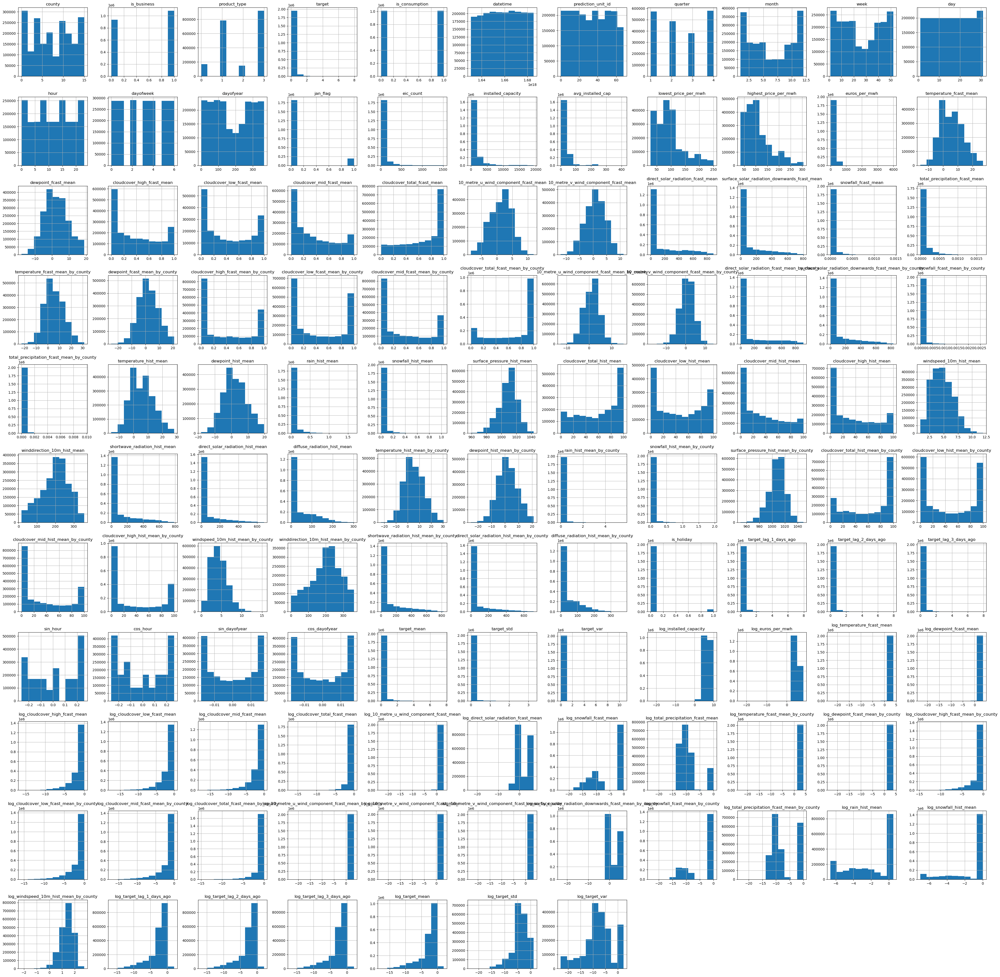

In [19]:
# Plot histogram for each variable
train.hist(figsize=(50, 50))
plt.show()


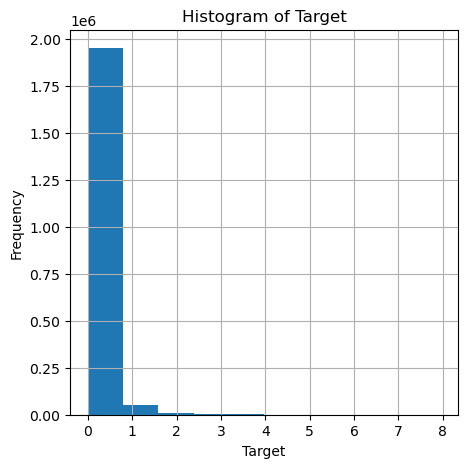

In [20]:
train['target'].hist(figsize=(5, 5))
plt.xlabel('Target')
plt.ylabel('Frequency')
plt.title('Histogram of Target')
plt.show()


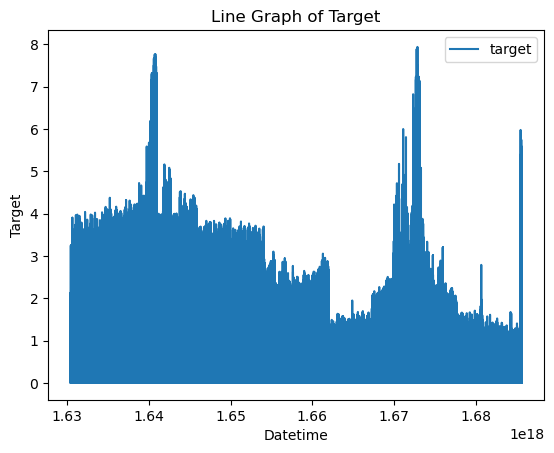

In [21]:
# Plot line graph
train.plot(x='datetime', y='target', kind='line')

# Set labels and title
plt.xlabel('Datetime')
plt.ylabel('Target')
plt.title('Line Graph of Target')

# Display the graph
plt.show()


## Modeling

In [22]:
# Select features and targets for consumption and production

consumption_X = train[train['is_consumption'] == 1].drop(['is_consumption', 'target'], axis=1)
consumption_y = train[train['is_consumption'] == 1]['target']

production_X = train[train['is_consumption'] == 0].drop(['is_consumption', 'target'], axis=1)
production_y = train[train['is_consumption'] == 0]['target']

In [23]:
# Normalize features

scaler = MinMaxScaler()
consumption_X = scaler.fit_transform(consumption_X)
production_X = scaler.fit_transform(production_X)

In [24]:
# Split into train and test sets

consumption_X_train, consumption_X_test, consumption_y_train, consumption_y_test = train_test_split(consumption_X, consumption_y, test_size=0.2, random_state=42)
production_X_train, production_X_test, production_y_train, production_y_test = train_test_split(production_X, production_y, test_size=0.2, random_state=42)


In [25]:
# Reshape features for LSTM
consumption_X_train = consumption_X_train.reshape((consumption_X_train.shape[0], 1, consumption_X_train.shape[1]))
consumption_X_test = consumption_X_test.reshape((consumption_X_test.shape[0], 1, consumption_X_test.shape[1]))

production_X_train = production_X_train.reshape((production_X_train.shape[0], 1, production_X_train.shape[1]))
production_X_test = production_X_test.reshape((production_X_test.shape[0], 1, production_X_test.shape[1]))

In [26]:
# Build LSTM model

# Consumption
consumption_model = Sequential()
consumption_model.add(LSTM(50, activation='relu', input_shape=(consumption_X_train.shape[1], consumption_X_train.shape[2])))
consumption_model.add(Dense(1))
consumption_model.compile(loss='mae', optimizer='adam')

# Production
production_model = Sequential()
production_model.add(LSTM(50, activation='relu', input_shape=(production_X_train.shape[1], production_X_train.shape[2])))
production_model.add(Dense(1))
production_model.compile(loss='mae', optimizer='adam')


Metal device set to: Apple M1 Pro

systemMemory: 16.00 GB
maxCacheSize: 5.33 GB



2024-01-17 19:10:45.868547: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2024-01-17 19:10:45.869919: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


In [27]:
# Fit LSTM model
consumption_history = consumption_model.fit(consumption_X_train, consumption_y_train, 
                                            epochs=5, batch_size=72, 
                                            validation_data=(consumption_X_test, consumption_y_test), 
                                            verbose=2, shuffle=False)

production_history = production_model.fit(production_X_train, production_y_train, 
                                          epochs=5, batch_size=72, 
                                          validation_data=(production_X_test, production_y_test), 
                                          verbose=2, shuffle=False)



Epoch 1/5


2024-01-17 19:10:46.868723: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2024-01-17 19:10:47.318898: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2024-01-17 19:12:47.080751: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11211/11211 - 133s - loss: 0.0570 - val_loss: 0.0519 - 133s/epoch - 12ms/step
Epoch 2/5
11211/11211 - 134s - loss: 0.0495 - val_loss: 0.0488 - 134s/epoch - 12ms/step
Epoch 3/5
11211/11211 - 136s - loss: 0.0483 - val_loss: 0.0484 - 136s/epoch - 12ms/step
Epoch 4/5
11211/11211 - 138s - loss: 0.0474 - val_loss: 0.0470 - 138s/epoch - 12ms/step
Epoch 5/5
11211/11211 - 132s - loss: 0.0468 - val_loss: 0.0461 - 132s/epoch - 12ms/step
Epoch 1/5


2024-01-17 19:22:01.591111: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2024-01-17 19:24:04.634920: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11211/11211 - 137s - loss: 0.0225 - val_loss: 0.0202 - 137s/epoch - 12ms/step
Epoch 2/5
11211/11211 - 141s - loss: 0.0201 - val_loss: 0.0196 - 141s/epoch - 13ms/step
Epoch 3/5
11211/11211 - 143s - loss: 0.0194 - val_loss: 0.0193 - 143s/epoch - 13ms/step
Epoch 4/5
11211/11211 - 134s - loss: 0.0189 - val_loss: 0.0188 - 134s/epoch - 12ms/step
Epoch 5/5
11211/11211 - 138s - loss: 0.0185 - val_loss: 0.0191 - 138s/epoch - 12ms/step


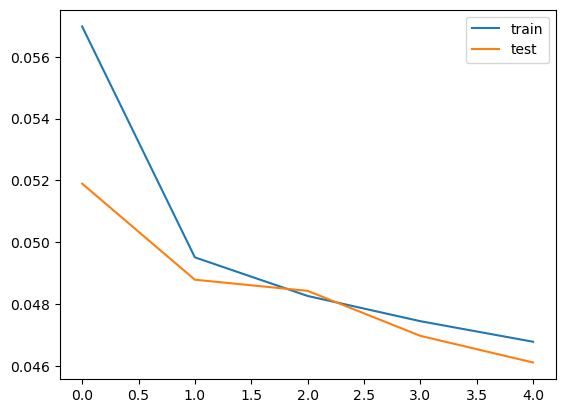

In [28]:
# Plot consumption loss
plt.plot(consumption_history.history['loss'], label='train')
plt.plot(consumption_history.history['val_loss'], label='test')
plt.legend()
plt.show()


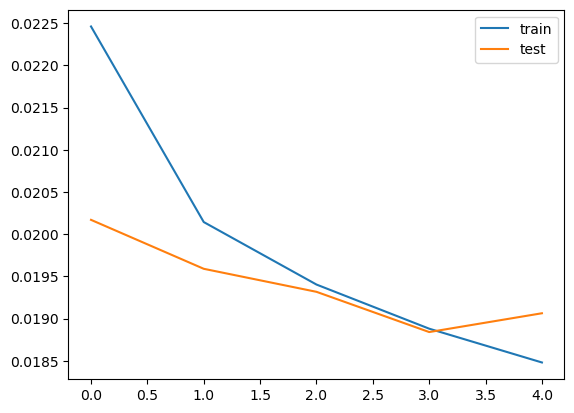

In [29]:
# Plot production loss
plt.plot(production_history.history['loss'], label='train')
plt.plot(production_history.history['val_loss'], label='test')
plt.legend()
plt.show()

In [30]:
# Make predictions
consumption_yhat = consumption_model.predict(consumption_X_test)

production_yhat = production_model.predict(production_X_test)

  26/6306 [..............................] - ETA: 26s 

2024-01-17 19:33:35.092444: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


  20/6306 [..............................] - ETA: 34s 

2024-01-17 19:34:04.052928: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


6306/6306 [==============================] - 27s 4ms/step


In [31]:
# Evaluate MAE
from sklearn.metrics import mean_absolute_error

consumption_mae = mean_absolute_error(consumption_y_test, consumption_yhat)
print('Consumption MAE: %.3f' % consumption_mae)

production_mae = mean_absolute_error(production_y_test, production_yhat)
print('Production MAE: %.3f' % production_mae)

Consumption MAE: 0.046
Production MAE: 0.019


In [123]:
bark = pd.DataFrame(consumption_yhat)
bark = pd.DataFrame(consumption_yhat).rename(columns={0: 'target'})
bark
roof = pd.DataFrame(consumption_X_test)
print(roof.shape)
print(bark.shape)
print(train.shape)

(201783, 115)
(201783, 1)
(2017824, 117)


In [216]:
consumption_y_test.shape


(201783,)

In [212]:
consumption_yhat

(201783, 1)

In [217]:
import numpy as np
consumption_y_testconsumption_y_test_array = np.array(consumption_y_test)
consumption_y_test_array


990201     0.035984
118585     0.132536
1783829    0.113792
1832097    0.022838
697347     0.073505
             ...   
1024995    0.001977
1437471    0.237721
1532605    0.733956
1711829    0.123185
1279951    0.092522
Name: target, Length: 201783, dtype: float64

In [213]:
consumption_yhat

array([[0.04753785],
       [0.11085439],
       [0.12999631],
       ...,
       [0.6873923 ],
       [0.11290197],
       [0.10761361]], dtype=float32)

## Results Visualization

In [229]:
def forcasted_results_consumption(x_df, yhat_df, y_df, base_df):
    '''Returns a dataframe with the forcasted results'''

    # Reshape features from 3D to 2D
    #x_df = x_df.reshape(x_df.shape[0], -1)

    y_df = np.array(y_df)
    # Convert features to dataframe
    consumption_df = pd.DataFrame(x_df)
    consumption_y = pd.DataFrame(y_df)
    consumption_yhat = pd.DataFrame(yhat_df)

    # Inverse transform features
    consumption_df = scaler.inverse_transform(consumption_df)
    consumption_df = pd.DataFrame(consumption_df)

    # Add actual targets to features dataframe
    consumption_df['actual_target'] = consumption_y
    actual_target_feat = consumption_df.pop('actual_target')
    consumption_df.insert(3, 'actual_target', actual_target_feat)

    # Add consumption column, set to 1
    consumption_df['is_consumption'] = 1
    consumption_feat = consumption_df.pop('is_consumption')
    consumption_df.insert(4, 'is_consumption', consumption_feat)
    
    #Rename columns back to origional names
    headers = base_df.columns
    consumption_df = consumption_df.rename(columns=dict(zip(consumption_df.columns, headers)))

    # Add predicted targets to features dataframe
    consumption_df['predicted_target'] = consumption_yhat
    predicted_target_feat = consumption_df.pop('predicted_target')

    # Insert the feature at the desired index
    consumption_df.insert(4, 'predicted_target', predicted_target_feat)

    # Convert to datetime format
    consumption_df['datetime'] = pd.to_datetime(consumption_df['datetime'])

    # Sort by datetime
    consumption_df.sort_values(['datetime', 'hour'], inplace=True)

    # Reset index
    consumption_df.reset_index(inplace=True)

    return consumption_df

In [230]:
consumption_df = forcasted_results_consumption(consumption_X_test, consumption_yhat, consumption_y_test, train)

In [231]:
consumption_df

,index,county,is_business,product_type,target,predicted_target,is_consumption,datetime,prediction_unit_id,quarter,month,week,day,hour,dayofweek,dayofyear,jan_flag,eic_count,installed_capacity,avg_installed_cap,lowest_price_per_mwh,highest_price_per_mwh,euros_per_mwh,temperature_fcast_mean,dewpoint_fcast_mean,cloudcover_high_fcast_mean,cloudcover_low_fcast_mean,cloudcover_mid_fcast_mean,cloudcover_total_fcast_mean,10_metre_u_wind_component_fcast_mean,10_metre_v_wind_component_fcast_mean,direct_solar_radiation_fcast_mean,surface_solar_radiation_downwards_fcast_mean,snowfall_fcast_mean,total_precipitation_fcast_mean,temperature_fcast_mean_by_county,dewpoint_fcast_mean_by_county,cloudcover_high_fcast_mean_by_county,cloudcover_low_fcast_mean_by_county,cloudcover_mid_fcast_mean_by_county,cloudcover_total_fcast_mean_by_county,10_metre_u_wind_component_fcast_mean_by_county,10_metre_v_wind_component_fcast_mean_by_county,direct_solar_radiation_fcast_mean_by_county,surface_solar_radiation_downwards_fcast_mean_by_county,snowfall_fcast_mean_by_county,total_precipitation_fcast_mean_by_county,temperature_hist_mean,dewpoint_hist_mean,rain_hist_mean,snowfall_hist_mean,surface_pressure_hist_mean,cloudcover_total_hist_mean,cloudcover_low_hist_mean,cloudcover_mid_hist_mean,cloudcover_high_hist_mean,windspeed_10m_hist_mean,winddirection_10m_hist_mean,shortwave_radiation_hist_mean,direct_solar_radiation_hist_mean,diffuse_radiation_hist_mean,temperature_hist_mean_by_county,dewpoint_hist_mean_by_county,rain_hist_mean_by_county,snowfall_hist_mean_by_county,surface_pressure_hist_mean_by_county,cloudcover_total_hist_mean_by_county,cloudcover_low_hist_mean_by_county,cloudcover_mid_hist_mean_by_county,cloudcover_high_hist_mean_by_county,windspeed_10m_hist_mean_by_county,winddirection_10m_hist_mean_by_county,shortwave_radiation_hist_mean_by_county,direct_solar_radiation_hist_mean_by_county,diffuse_radiation_hist_mean_by_county,is_holiday,target_lag_1_days_ago,target_lag_2_days_ago,target_lag_3_days_ago,sin_hour,cos_hour,sin_dayofyear,cos_dayofyear,target_mean,target_std,target_var,log_installed_capacity,log_euros_per_mwh,log_temperature_fcast_mean,log_dewpoint_fcast_mean,log_cloudcover_high_fcast_mean,log_cloudcover_low_fcast_mean,log_cloudcover_mid_fcast_mean,log_cloudcover_total_fcast_mean,log_10_metre_u_wind_component_fcast_mean,log_direct_solar_radiation_fcast_mean,log_snowfall_fcast_mean,log_total_precipitation_fcast_mean,log_temperature_fcast_mean_by_county,log_dewpoint_fcast_mean_by_county,log_cloudcover_high_fcast_mean_by_county,log_cloudcover_low_fcast_mean_by_county,log_cloudcover_mid_fcast_mean_by_county,log_cloudcover_total_fcast_mean_by_county,log_10_metre_u_wind_component_fcast_mean_by_county,log_10_metre_v_wind_component_fcast_mean,log_10_metre_v_wind_component_fcast_mean_by_county,log_surface_solar_radiation_downwards_fcast_mean_by_county,log_snowfall_fcast_mean_by_county,log_total_precipitation_fcast_mean_by_county,log_rain_hist_mean,log_snowfall_hist_mean,log_windspeed_10m_hist_mean_by_county,log_target_lag_1_days_ago,log_target_lag_2_days_ago,log_target_lag_3_days_ago,log_target_mean,log_target_std,log_target_var
0,219,13.0,1.0,3.0,0.650538,0.081080,1,2021-09-01 00:00:00,52.0,3.0,9.0,35.0,1.0,0.0,2.0,244.0,0.0,29.0,1152.9,39.755172,50.15,69.99,71.36,13.014066,10.531545,0.256954,0.213331,0.069662,0.438023,1.970332,-5.205125,0.0,0.0,0.0,0.0,10.058984,9.031396,0.248322,0.104279,0.066223,0.332809,1.523974,-2.439878,0.0,0.0,0.0,0.0,8.982667,6.233333,0.0,0.0,1026.648000,85.293333,82.560000,20.013333,1.413333,4.854074,145.973333,3.786667,1.186667,2.6,8.840000,6.710000,0.0,0.0,1028.510000,93.300000,87.60,24.20,0.000000,4.169444,143.000000,0.0,0.0,0.0,0.0,0.046276,0.007003,0.006726,0.00000,0.261799,-0.014842,0.008628,0.018545,0.002547,0.000006,7.045254,4.399621,3.350600,3.349613,-1.358858,-1.544909,-2.664093,-0.825485,2.337719,0.0,0.0,0.0,3.486922,3.523462,-1.393031,-2.260689,-2.714725,-1.100185,2.646491,1.911429,2.743804,0.0,0.0,0.0,0.0,0.0,1.42

In [232]:
# Sort the DataFrame by 'datetime' for proper time series plotting
# Plot actual vs predicted values over datetime_x
plt.figure(figsize=(150, 40))  # Adjust the figure size as needed
plt.plot(consumption_df['datetime'], consumption_df['target'], label='Actual Values', linewidth=2, color='blue')
plt.plot(consumption_df['datetime'], consumption_df['predicted_target'], label='Predicted Values', linestyle='--', linewidth=2, color='orange')
plt.xlabel('Datetime')
plt.ylabel('Values')
plt.title('Actual vs Predicted Values over Datetime')
plt.legend(loc='upper left')
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()  # Improves spacing
plt.show()

In [120]:
def forcasted_results_production(x_df, y_df, train_df):
    '''Returns a dataframe with the forcasted results'''

    base_df = train_df.copy()

    # Reshape features from 3D to 2D
    x_df = x_df.reshape(x_df.shape[0], -1)

    # Convert features to dataframe
    production_df = pd.DataFrame(x_df)
    production_y = pd.DataFrame(y_df)

    # Inverse transform features
    production_df = scaler.inverse_transform(production_df)
    production_df = pd.DataFrame(production_df)

    # Add predicted targets to features dataframe
    production_df['target'] = production_y

    # Add production column, set to 1
    production_df['is_consumption'] = 0

    # Move target and consumption columns to origional index
    # Remove the feature from its current position
    target_feat = production_df.pop('target')
    production_feat = production_df.pop('is_consumption')

    # Insert the feature at the desired index
    production_df.insert(3, 'target', target_feat)
    production_df.insert(4, 'is_consumption', production_feat)

    #Rename columns back to origional names
    headers = base_df.columns
    production_df = production_df.rename(columns=dict(zip(production_df.columns, headers)))

    # Convert to datetime format
    production_df['datetime'] = pd.to_datetime(production_df['datetime'])
    base_df['datetime'] = pd.to_datetime(base_df['datetime'])

    # Merge base_df and production_df
    base_df.rename(columns={'target': 'actual_values'}, inplace=True)
    production_df.rename(columns={'target': 'predicted_values'}, inplace=True)
    
    # Unique identifiers
    actual_values = base_df['actual_values']
    base_df = base_df.drop('actual_values', axis=1)

    predicted_values = production_df['predicted_values']
    production_df = production_df.drop('predicted_values', axis=1)

    unique_identifiers = production_df.columns
    # Merge df with train based on unique identifiers
    production_merged_df = production_df.merge(base_df, how='left', on=unique_identifiers)
    
    production_merged_df['actual_values'] = actual_values
    production_merged_df['predicted_values'] = predicted_values


    return production_merged_df

In [ ]:
forcasted_results_production(x_df, y_df, train_df)


In [199]:
#def forcasted_results_consumption(x_df, y_df, train_df, scaler):
    '''Returns a dataframe with the forecasted results'''

    base_df = train_df.copy()
    base_df = base_df.astype('float64')
    # Convert features to dataframe
    consumption_df = pd.DataFrame(x_df)

    # Inverse transform features
    consumption_df = pd.DataFrame(scaler.inverse_transform(consumption_df), columns=consumption_df.columns)

    # Add predicted targets to features dataframe
    consumption_df['target'] = y_df

    # Add consumption column, set to 1
    consumption_df['is_consumption'] = 1

    # Move target and consumption columns to original index
    target_feat = consumption_df.pop('target')
    consumption_feat = consumption_df.pop('is_consumption')

    # Insert the feature at the desired index
    consumption_df.insert(3, 'target', target_feat)
    consumption_df.insert(4, 'is_consumption', consumption_feat)

    # Rename columns back to original names
    headers = base_df.columns
    consumption_df = consumption_df.rename(columns=dict(zip(consumption_df.columns, headers)))
    consumption_df = consumption_df.astype('float64')
    # Convert to datetime format
    # base_df['datetime'] = pd.to_datetime(base_df['datetime'])

    # Merge base_df and consumption_df
    #base_df.rename(columns={'target': 'actual_values'}, inplace=True)
    #consumption_df.rename(columns={'target': 'predicted_values'}, inplace=True)

    # Unique identifiers
    # predicted_values = consumption_df['predicted_values']
    # consumption_df = consumption_df.drop('predicted_values', axis=1)

    #unique_identifiers = consumption_df.columns
    unique_identifiers = ('county', 'is_business', 'product_type', 'is_consumption', 'datetime', 'prediction_unit_id', 'quarter', 'month', 'week', 'day', 'hour', 'dayofweek','dayofyear', 'jan_flag',  'eic_count', 'installed_capacity', 'avg_installed_cap','lowest_price_per_mwh', 'highest_price_per_mwh', 'euros_per_mwh', 'temperature_fcast_mean', 'dewpoint_fcast_mean', 'cloudcover_high_fcast_mean', 'cloudcover_low_fcast_mean',	'cloudcover_mid_fcast_mean',	'cloudcover_total_fcast_mean',	'10_metre_u_wind_component_fcast_mean',	'10_metre_v_wind_component_fcast_mean',	'direct_solar_radiation_fcast_mean',	'surface_solar_radiation_downwards_fcast_mean',	'snowfall_fcast_mean',	'total_precipitation_fcast_mean',	'temperature_fcast_mean_by_county',	'dewpoint_fcast_mean_by_county',	'cloudcover_high_fcast_mean_by_county',	'cloudcover_low_fcast_mean_by_county',	'cloudcover_mid_fcast_mean_by_county',	'cloudcover_total_fcast_mean_by_county',	'10_metre_u_wind_component_fcast_mean_by_county',	'10_metre_v_wind_component_fcast_mean_by_county',	'direct_solar_radiation_fcast_mean_by_county',	'surface_solar_radiation_downwards_fcast_mean_by_county',	'snowfall_fcast_mean_by_county',	'total_precipitation_fcast_mean_by_county',	'temperature_hist_mean',	'dewpoint_hist_mean',	'rain_hist_mean',	'snowfall_hist_mean',	'surface_pressure_hist_mean',	'cloudcover_total_hist_mean',	'cloudcover_low_hist_mean',	'cloudcover_mid_hist_mean',	'cloudcover_high_hist_mean',	'windspeed_10m_hist_mean',	'winddirection_10m_hist_mean',	'shortwave_radiation_hist_mean',	'direct_solar_radiation_hist_mean',	'diffuse_radiation_hist_mean',	'temperature_hist_mean_by_county',	'dewpoint_hist_mean_by_county',	'rain_hist_mean_by_county',	'snowfall_hist_mean_by_county',	'surface_pressure_hist_mean_by_county',	'cloudcover_total_hist_mean_by_county',	'cloudcover_low_hist_mean_by_county',	'cloudcover_mid_hist_mean_by_county',	'cloudcover_high_hist_mean_by_county',	'windspeed_10m_hist_mean_by_county',	'winddirection_10m_hist_mean_by_county',	'shortwave_radiation_hist_mean_by_county',	'direct_solar_radiation_hist_mean_by_county',	'diffuse_radiation_hist_mean_by_county',	'is_holiday',	'target_lag_1_days_ago',	'target_lag_2_days_ago',	'target_lag_3_days_ago',	'sin_hour',	'cos_hour',	'sin_dayofyear',	'cos_dayofyear',	'target_mean',	'target_std',	'target_var',	'log_installed_capacity',	'log_euros_per_mwh',	'log_temperature_fcast_mean',	'log_dewpoint_fcast_mean',	'log_cloudcover_high_fcast_mean',	'log_cloudcover_low_fcast_mean',	'log_cloudcover_mid_fcast_mean',	'log_cloudcover_total_fcast_mean',	'log_10_metre_u_wind_component_fcast_mean',	'log_direct_solar_radiation_fcast_mean',	'log_snowfall_fcast_mean',	'log_total_precipitation_fcast_mean',	'log_temperature_fcast_mean_by_county',	'log_dewpoint_fcast_mean_by_county',	'log_cloudcover_high_fcast_mean_by_county',	'log_cloudcover_low_fcast_mean_by_county',	'log_cloudcover_mid_fcast_mean_by_county',	'log_cloudcover_total_fcast_mean_by_county',	'log_10_metre_u_wind_component_fcast_mean_by_county',	'log_10_metre_v_wind_component_fcast_mean',	'log_10_metre_v_wind_component_fcast_mean_by_county',	'log_surface_solar_radiation_downwards_fcast_mean_by_county',	'log_snowfall_fcast_mean_by_county',	'log_total_precipitation_fcast_mean_by_county',	'log_rain_hist_mean',	'log_snowfall_hist_mean',	'log_windspeed_10m_hist_mean_by_county',	'log_target_lag_1_days_ago',	'log_target_lag_2_days_ago',	'log_target_lag_3_days_ago',	'log_target_mean',	'log_target_std',	'log_target_var')
    # consumption_df = consumption_df.reset_index(drop=True)
    # base_df = base_df.reset_index(drop=True)
    # Merge df with train based on unique identifiers
    
    consumption_merged_df = consumption_df.merge(base_df, how='left', on=unique_identifiers)

    # consumption_merged_df['predicted_values'] = predicted_values
    
    
    # COME BACK TO consumption_merged_df['datetime'] = pd.to_datetime(consumption_merged_df['datetime'])

    return consumption_merged_df


In [80]:
consumption_X_test.shape

(201783, 115)

In [81]:
consumption_yhat.shape

(201783, 1)

In [200]:
consumption_merged_df = forcasted_results_consumption(consumption_X_test, consumption_yhat, train, scaler)


In [ ]:
# Sort the DataFrame by 'datetime_x' for proper time series plotting
consumption_merged_df.sort_values(by='datetime_x', inplace=True)

# Plot actual vs predicted values over datetime_x_x
plt.figure(figsize=(150, 40))  # Adjust the figure size as needed
plt.plot(consumption_merged_df['datetime_x'], consumption_merged_df['actual_values'], label='Actual Values', linewidth=2, color='blue')
plt.plot(consumption_merged_df['datetime_x'], consumption_merged_df['predicted_values'], label='Predicted Values', linestyle='--', linewidth=2, color='orange')
plt.xlabel('Datetime')
plt.ylabel('Values')
plt.title('Actual vs Predicted Values over Datetime')
plt.legend(loc='upper left')
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()  # Improves spacing
plt.show()

In [201]:
consumption_merged_df

,county,is_business,product_type,target_x,is_consumption,datetime,prediction_unit_id,quarter,month,week,day,hour,dayofweek,dayofyear,jan_flag,eic_count,installed_capacity,avg_installed_cap,lowest_price_per_mwh,highest_price_per_mwh,euros_per_mwh,temperature_fcast_mean,dewpoint_fcast_mean,cloudcover_high_fcast_mean,cloudcover_low_fcast_mean,cloudcover_mid_fcast_mean,cloudcover_total_fcast_mean,10_metre_u_wind_component_fcast_mean,10_metre_v_wind_component_fcast_mean,direct_solar_radiation_fcast_mean,surface_solar_radiation_downwards_fcast_mean,snowfall_fcast_mean,total_precipitation_fcast_mean,temperature_fcast_mean_by_county,dewpoint_fcast_mean_by_county,cloudcover_high_fcast_mean_by_county,cloudcover_low_fcast_mean_by_county,cloudcover_mid_fcast_mean_by_county,cloudcover_total_fcast_mean_by_county,10_metre_u_wind_component_fcast_mean_by_county,10_metre_v_wind_component_fcast_mean_by_county,direct_solar_radiation_fcast_mean_by_county,surface_solar_radiation_downwards_fcast_mean_by_county,snowfall_fcast_mean_by_county,total_precipitation_fcast_mean_by_county,temperature_hist_mean,dewpoint_hist_mean,rain_hist_mean,snowfall_hist_mean,surface_pressure_hist_mean,cloudcover_total_hist_mean,cloudcover_low_hist_mean,cloudcover_mid_hist_mean,cloudcover_high_hist_mean,windspeed_10m_hist_mean,winddirection_10m_hist_mean,shortwave_radiation_hist_mean,direct_solar_radiation_hist_mean,diffuse_radiation_hist_mean,temperature_hist_mean_by_county,dewpoint_hist_mean_by_county,rain_hist_mean_by_county,snowfall_hist_mean_by_county,surface_pressure_hist_mean_by_county,cloudcover_total_hist_mean_by_county,cloudcover_low_hist_mean_by_county,cloudcover_mid_hist_mean_by_county,cloudcover_high_hist_mean_by_county,windspeed_10m_hist_mean_by_county,winddirection_10m_hist_mean_by_county,shortwave_radiation_hist_mean_by_county,direct_solar_radiation_hist_mean_by_county,diffuse_radiation_hist_mean_by_county,is_holiday,target_lag_1_days_ago,target_lag_2_days_ago,target_lag_3_days_ago,sin_hour,cos_hour,sin_dayofyear,cos_dayofyear,target_mean,target_std,target_var,log_installed_capacity,log_euros_per_mwh,log_temperature_fcast_mean,log_dewpoint_fcast_mean,log_cloudcover_high_fcast_mean,log_cloudcover_low_fcast_mean,log_cloudcover_mid_fcast_mean,log_cloudcover_total_fcast_mean,log_10_metre_u_wind_component_fcast_mean,log_direct_solar_radiation_fcast_mean,log_snowfall_fcast_mean,log_total_precipitation_fcast_mean,log_temperature_fcast_mean_by_county,log_dewpoint_fcast_mean_by_county,log_cloudcover_high_fcast_mean_by_county,log_cloudcover_low_fcast_mean_by_county,log_cloudcover_mid_fcast_mean_by_county,log_cloudcover_total_fcast_mean_by_county,log_10_metre_u_wind_component_fcast_mean_by_county,log_10_metre_v_wind_component_fcast_mean,log_10_metre_v_wind_component_fcast_mean_by_county,log_surface_solar_radiation_downwards_fcast_mean_by_county,log_snowfall_fcast_mean_by_county,log_total_precipitation_fcast_mean_by_county,log_rain_hist_mean,log_snowfall_hist_mean,log_windspeed_10m_hist_mean_by_county,log_target_lag_1_days_ago,log_target_lag_2_days_ago,log_target_lag_3_days_ago,log_target_mean,log_target_std,log_target_var,target_y
0,3.0,0.0,1.0,0.047538,1.0,1.657886e+18,11.0,3.0,7.0,28.0,15.0,12.0,4.0,196.0,0.0,30.0,311.00,10.366667,162.00,175.00,343.52,16.298576,10.979878,0.428160,0.273348,0.290931,0.647104,5.347474,-0.938468,431.000276,517.410507,0.000000e+00,3.631812e-04,16.302291,11.364994,0.883387,0.497111,0.453027,0.968177,4.446066,0.362388,310.488750,473.781944,0.000000,1.293026e-03,20.333333,14.078667,0.136000,0.000000,1004.770667,47.506667,37.386667,29.413333,38.293333,3.833704,267.373333,577.200000,432.533333,144.666667,21.400000,12.400000,0.00,0.0,1000.333333,3.000000,3.000000,0.000000,0.000000,3.629630,283.000000,787.333333,658.333333,129.000000,0.0,0.029434,0.001585,0.004064,-0.140474,0.220920,0.016129,0.005879,0.009085,0.012865,1.655135e-04,5.721950,5.868110,3.459603,3.365226,-0.848258,-1.297011,-1.234670,-0.435248,2.619927,6.066232,0.000000,-7.915403,3

In [203]:
train.query("county == 1 & is_business == 0 & product_type == 1 & prediction_unit_id == 11 & quarter == 3 & month == 7 and day == 15 & hour == 12 and dayofweek == 4 and log_target_std == 8.714049")

,county,is_business,product_type,target,is_consumption,datetime,prediction_unit_id,quarter,month,week,day,hour,dayofweek,dayofyear,jan_flag,eic_count,installed_capacity,avg_installed_cap,lowest_price_per_mwh,highest_price_per_mwh,euros_per_mwh,temperature_fcast_mean,dewpoint_fcast_mean,cloudcover_high_fcast_mean,cloudcover_low_fcast_mean,cloudcover_mid_fcast_mean,cloudcover_total_fcast_mean,10_metre_u_wind_component_fcast_mean,10_metre_v_wind_component_fcast_mean,direct_solar_radiation_fcast_mean,surface_solar_radiation_downwards_fcast_mean,snowfall_fcast_mean,total_precipitation_fcast_mean,temperature_fcast_mean_by_county,dewpoint_fcast_mean_by_county,cloudcover_high_fcast_mean_by_county,cloudcover_low_fcast_mean_by_county,cloudcover_mid_fcast_mean_by_county,cloudcover_total_fcast_mean_by_county,10_metre_u_wind_component_fcast_mean_by_county,10_metre_v_wind_component_fcast_mean_by_county,direct_solar_radiation_fcast_mean_by_county,surface_solar_radiation_downwards_fcast_mean_by_county,snowfall_fcast_mean_by_county,total_precipitation_fcast_mean_by_county,temperature_hist_mean,dewpoint_hist_mean,rain_hist_mean,snowfall_hist_mean,surface_pressure_hist_mean,cloudcover_total_hist_mean,cloudcover_low_hist_mean,cloudcover_mid_hist_mean,cloudcover_high_hist_mean,windspeed_10m_hist_mean,winddirection_10m_hist_mean,shortwave_radiation_hist_mean,direct_solar_radiation_hist_mean,diffuse_radiation_hist_mean,temperature_hist_mean_by_county,dewpoint_hist_mean_by_county,rain_hist_mean_by_county,snowfall_hist_mean_by_county,surface_pressure_hist_mean_by_county,cloudcover_total_hist_mean_by_county,cloudcover_low_hist_mean_by_county,cloudcover_mid_hist_mean_by_county,cloudcover_high_hist_mean_by_county,windspeed_10m_hist_mean_by_county,winddirection_10m_hist_mean_by_county,shortwave_radiation_hist_mean_by_county,direct_solar_radiation_hist_mean_by_county,diffuse_radiation_hist_mean_by_county,is_holiday,target_lag_1_days_ago,target_lag_2_days_ago,target_lag_3_days_ago,sin_hour,cos_hour,sin_dayofyear,cos_dayofyear,target_mean,target_std,target_var,log_installed_capacity,log_euros_per_mwh,log_temperature_fcast_mean,log_dewpoint_fcast_mean,log_cloudcover_high_fcast_mean,log_cloudcover_low_fcast_mean,log_cloudcover_mid_fcast_mean,log_cloudcover_total_fcast_mean,log_10_metre_u_wind_component_fcast_mean,log_direct_solar_radiation_fcast_mean,log_snowfall_fcast_mean,log_total_precipitation_fcast_mean,log_temperature_fcast_mean_by_county,log_dewpoint_fcast_mean_by_county,log_cloudcover_high_fcast_mean_by_county,log_cloudcover_low_fcast_mean_by_county,log_cloudcover_mid_fcast_mean_by_county,log_cloudcover_total_fcast_mean_by_county,log_10_metre_u_wind_component_fcast_mean_by_county,log_10_metre_v_wind_component_fcast_mean,log_10_metre_v_wind_component_fcast_mean_by_county,log_surface_solar_radiation_downwards_fcast_mean_by_county,log_snowfall_fcast_mean_by_county,log_total_precipitation_fcast_mean_by_county,log_rain_hist_mean,log_snowfall_hist_mean,log_windspeed_10m_hist_mean_by_county,log_target_lag_1_days_ago,log_target_lag_2_days_ago,log_target_lag_3_days_ago,log_target_mean,log_target_std,log_target_var


In [202]:
pd.set_option('display.max_columns', None)
consumption_merged_df.isna().sum()

county                                                             0
is_business                                                        0
product_type                                                       0
target_x                                                           0
is_consumption                                                     0
datetime                                                           0
prediction_unit_id                                                 0
quarter                                                            0
month                                                              0
week                                                               0
day                                                                0
hour                                                               0
dayofweek                                                          0
dayofyear                                                          0
jan_flag                          

In [182]:
consumption_merged_df.info(verbose=True)

unique_identifiers = ('county', 'is_business', 'product_type', 'is_consumption', 'datetime', 'prediction_unit_id', 'quarter', 'month', 'week', 'day', 'hour', 'dayofweek','dayofyear', 'jan_flag',  'eic_count', 'installed_capacity', 'avg_installed_cap','lowest_price_per_mwh', 'highest_price_per_mwh', 'euros_per_mwh', 'temperature_fcast_mean', 'dewpoint_fcast_mean', 'cloudcover_high_fcast_mean')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 201783 entries, 0 to 201782
Data columns (total 117 columns):
 #    Column                                                      Dtype  
---   ------                                                      -----  
 0    county                                                      float64
 1    is_business                                                 float64
 2    product_type                                                float64
 3    target                                                      float64
 4    is_consumption                                              float64
 5    datetime                                                    float64
 6    prediction_unit_id                                          float64
 7    quarter                                                     float64
 8    month                                                       float64
 9    week                                                        float64


In [181]:
base_df.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2017824 entries, 0 to 2017823
Data columns (total 117 columns):
 #    Column                                                      Dtype  
---   ------                                                      -----  
 0    county                                                      float64
 1    is_business                                                 float64
 2    product_type                                                float64
 3    target                                                      float64
 4    is_consumption                                              float64
 5    datetime                                                    float64
 6    prediction_unit_id                                          float64
 7    quarter                                                     float64
 8    month                                                       float64
 9    week                                                        float6

In [183]:
con_cols = consumption_merged_df.columns
train_cols = base_df.columns

if set(con_cols) == set(train_cols):
    print(True)
else:
    print(False)

True


In [144]:
pd.set_option('display.max_columns', None)
unique_identifiers = pd.DataFrame(unique_identifiers)
unique_identifiers

,0
0,county
1,is_business
2,product_type
3,is_consumption
4,datetime
5,prediction_unit_id
6,quarter
7,month
8,week
9,day


In [145]:
train_col = train.columns
train_col = pd.DataFrame(train_col)
train_col

,0
0,county
1,is_business
2,product_type
3,target
4,is_consumption
5,datetime
6,prediction_unit_id
7,quarter
8,month
9,week


In [121]:
consumption_merged_df = forcasted_results_consumption(consumption_X_test, consumption_yhat, train)
production_merged_df = forcasted_results_production(production_X_test, production_yhat, train)

KeyError: Index(['county', 'is_business', 'product_type', 'is_consumption', 'datetime',
       'prediction_unit_id', 'quarter', 'month', 'week', 'day',
       ...
       'log_total_precipitation_fcast_mean_by_county', 'log_rain_hist_mean',
       'log_snowfall_hist_mean', 'log_windspeed_10m_hist_mean_by_county',
       'log_target_lag_1_days_ago', 'log_target_lag_2_days_ago',
       'log_target_lag_3_days_ago', 'log_target_mean', 'log_target_std',
       'log_target_var'],
      dtype='object', length=116)

In [113]:
train.query("prediction_unit_id == 11 and county == 3 and hour == 12 and week == 28 and is_consumption == 1 and dayofyear == 196")

,county,is_business,product_type,target,is_consumption,datetime,prediction_unit_id,quarter,month,week,day,hour,dayofweek,dayofyear,jan_flag,eic_count,installed_capacity,avg_installed_cap,lowest_price_per_mwh,highest_price_per_mwh,euros_per_mwh,temperature_fcast_mean,dewpoint_fcast_mean,cloudcover_high_fcast_mean,cloudcover_low_fcast_mean,cloudcover_mid_fcast_mean,cloudcover_total_fcast_mean,10_metre_u_wind_component_fcast_mean,10_metre_v_wind_component_fcast_mean,direct_solar_radiation_fcast_mean,surface_solar_radiation_downwards_fcast_mean,snowfall_fcast_mean,total_precipitation_fcast_mean,temperature_fcast_mean_by_county,dewpoint_fcast_mean_by_county,cloudcover_high_fcast_mean_by_county,cloudcover_low_fcast_mean_by_county,cloudcover_mid_fcast_mean_by_county,cloudcover_total_fcast_mean_by_county,10_metre_u_wind_component_fcast_mean_by_county,10_metre_v_wind_component_fcast_mean_by_county,direct_solar_radiation_fcast_mean_by_county,surface_solar_radiation_downwards_fcast_mean_by_county,snowfall_fcast_mean_by_county,total_precipitation_fcast_mean_by_county,temperature_hist_mean,dewpoint_hist_mean,rain_hist_mean,snowfall_hist_mean,surface_pressure_hist_mean,cloudcover_total_hist_mean,cloudcover_low_hist_mean,cloudcover_mid_hist_mean,cloudcover_high_hist_mean,windspeed_10m_hist_mean,winddirection_10m_hist_mean,shortwave_radiation_hist_mean,direct_solar_radiation_hist_mean,diffuse_radiation_hist_mean,temperature_hist_mean_by_county,dewpoint_hist_mean_by_county,rain_hist_mean_by_county,snowfall_hist_mean_by_county,surface_pressure_hist_mean_by_county,cloudcover_total_hist_mean_by_county,cloudcover_low_hist_mean_by_county,cloudcover_mid_hist_mean_by_county,cloudcover_high_hist_mean_by_county,windspeed_10m_hist_mean_by_county,winddirection_10m_hist_mean_by_county,shortwave_radiation_hist_mean_by_county,direct_solar_radiation_hist_mean_by_county,diffuse_radiation_hist_mean_by_county,is_holiday,target_lag_1_days_ago,target_lag_2_days_ago,target_lag_3_days_ago,sin_hour,cos_hour,sin_dayofyear,cos_dayofyear,target_mean,target_std,target_var,log_installed_capacity,log_euros_per_mwh,log_temperature_fcast_mean,log_dewpoint_fcast_mean,log_cloudcover_high_fcast_mean,log_cloudcover_low_fcast_mean,log_cloudcover_mid_fcast_mean,log_cloudcover_total_fcast_mean,log_10_metre_u_wind_component_fcast_mean,log_direct_solar_radiation_fcast_mean,log_snowfall_fcast_mean,log_total_precipitation_fcast_mean,log_temperature_fcast_mean_by_county,log_dewpoint_fcast_mean_by_county,log_cloudcover_high_fcast_mean_by_county,log_cloudcover_low_fcast_mean_by_county,log_cloudcover_mid_fcast_mean_by_county,log_cloudcover_total_fcast_mean_by_county,log_10_metre_u_wind_component_fcast_mean_by_county,log_10_metre_v_wind_component_fcast_mean,log_10_metre_v_wind_component_fcast_mean_by_county,log_surface_solar_radiation_downwards_fcast_mean_by_county,log_snowfall_fcast_mean_by_county,log_total_precipitation_fcast_mean_by_county,log_rain_hist_mean,log_snowfall_hist_mean,log_windspeed_10m_hist_mean_by_county,log_target_lag_1_days_ago,log_target_lag_2_days_ago,log_target_lag_3_days_ago,log_target_mean,log_target_std,log_target_var
990201,3.0,0.0,1.0,0.035984,1.0,1.657886e+18,11.0,3.0,7.0,28.0,15.0,12.0,4.0,196.0,0.0,30.0,311.0,10.366667,162.0,175.0,343.52,16.298576,10.979878,0.42816,0.273348,0.290931,0.647104,5.347474,-0.938468,431.000276,517.410507,0.0,0.000363,16.302291,11.364994,0.883387,0.497111,0.453027,0.968177,4.446066,0.362388,310.48875,473.781944,0.0,0.001293,20.333333,14.078667,0.136,0.0,1004.770667,47.506667,37.386667,29.413333,38.293333,3.833704,267.373333,577.2,432.533333,144.666667,21.4,12.4,0.0,0.0,1000.333333,3.0,3.0,0.0,0.0,3.62963,283.0,787.333333,658.333333,129.0,0.0,0.039096,0.013212,0.033875,-0.140474,0.22092,0.016129,0.005879,0.028728,0.013688,0.000187,5.72195,5.86811,3.459603,3.365226,-0.848258,-1.297011,-1.23467,-0.435248,2.619927,6.066232,0.0,-7.915403,3.661727,3.590031,-0.123992,-0.698942,-0.791804,-0.032341,2.834774,2.400565,2.909535,6.161133,0.0,-6.6

In [112]:
consumption_merged_df.query("actual_values.isna()")

,county,is_business,product_type,predicted_values,is_consumption,datetime_x,prediction_unit_id,quarter,month,week,day,hour,dayofweek,dayofyear,jan_flag_x,eic_count_x,installed_capacity_x,avg_installed_cap,lowest_price_per_mwh_x,highest_price_per_mwh_x,euros_per_mwh_x,temperature_fcast_mean_x,dewpoint_fcast_mean_x,cloudcover_high_fcast_mean_x,cloudcover_low_fcast_mean_x,cloudcover_mid_fcast_mean_x,cloudcover_total_fcast_mean_x,10_metre_u_wind_component_fcast_mean_x,10_metre_v_wind_component_fcast_mean_x,direct_solar_radiation_fcast_mean_x,surface_solar_radiation_downwards_fcast_mean_x,snowfall_fcast_mean_x,total_precipitation_fcast_mean_x,temperature_fcast_mean_by_county_x,dewpoint_fcast_mean_by_county_x,cloudcover_high_fcast_mean_by_county_x,cloudcover_low_fcast_mean_by_county_x,cloudcover_mid_fcast_mean_by_county_x,cloudcover_total_fcast_mean_by_county_x,10_metre_u_wind_component_fcast_mean_by_county_x,10_metre_v_wind_component_fcast_mean_by_county_x,direct_solar_radiation_fcast_mean_by_county_x,surface_solar_radiation_downwards_fcast_mean_by_county_x,snowfall_fcast_mean_by_county_x,total_precipitation_fcast_mean_by_county_x,temperature_hist_mean_x,dewpoint_hist_mean_x,rain_hist_mean_x,snowfall_hist_mean_x,surface_pressure_hist_mean_x,cloudcover_total_hist_mean_x,cloudcover_low_hist_mean_x,cloudcover_mid_hist_mean_x,cloudcover_high_hist_mean_x,windspeed_10m_hist_mean_x,winddirection_10m_hist_mean_x,shortwave_radiation_hist_mean_x,direct_solar_radiation_hist_mean_x,diffuse_radiation_hist_mean_x,temperature_hist_mean_by_county_x,dewpoint_hist_mean_by_county_x,rain_hist_mean_by_county_x,snowfall_hist_mean_by_county_x,surface_pressure_hist_mean_by_county_x,cloudcover_total_hist_mean_by_county_x,cloudcover_low_hist_mean_by_county_x,cloudcover_mid_hist_mean_by_county_x,cloudcover_high_hist_mean_by_county_x,windspeed_10m_hist_mean_by_county_x,winddirection_10m_hist_mean_by_county_x,shortwave_radiation_hist_mean_by_county_x,direct_solar_radiation_hist_mean_by_county_x,diffuse_radiation_hist_mean_by_county_x,is_holiday_x,target_lag_1_days_ago_x,target_lag_2_days_ago_x,target_lag_3_days_ago_x,sin_hour_x,cos_hour_x,sin_dayofyear_x,cos_dayofyear_x,target_mean_x,target_std_x,target_var_x,log_installed_capacity_x,log_euros_per_mwh_x,log_temperature_fcast_mean_x,log_dewpoint_fcast_mean_x,log_cloudcover_high_fcast_mean_x,log_cloudcover_low_fcast_mean_x,log_cloudcover_mid_fcast_mean_x,log_cloudcover_total_fcast_mean_x,log_10_metre_u_wind_component_fcast_mean_x,log_direct_solar_radiation_fcast_mean_x,log_snowfall_fcast_mean_x,log_total_precipitation_fcast_mean_x,log_temperature_fcast_mean_by_county_x,log_dewpoint_fcast_mean_by_county_x,log_cloudcover_high_fcast_mean_by_county_x,log_cloudcover_low_fcast_mean_by_county_x,log_cloudcover_mid_fcast_mean_by_county_x,log_cloudcover_total_fcast_mean_by_county_x,log_10_metre_u_wind_component_fcast_mean_by_county_x,log_10_metre_v_wind_component_fcast_mean_x,log_10_metre_v_wind_component_fcast_mean_by_county_x,log_surface_solar_radiation_downwards_fcast_mean_by_county_x,log_snowfall_fcast_mean_by_county_x,log_total_precipitation_fcast_mean_by_county_x,log_rain_hist_mean_x,log_snowfall_hist_mean_x,log_windspeed_10m_hist_mean_by_county_x,log_target_lag_1_days_ago_x,log_target_lag_2_days_ago_x,log_target_lag_3_days_ago_x,log_target_mean_x,log_target_std_x,log_target_var_x,actual_values,datetime_y,jan_flag_y,eic_count_y,installed_capacity_y,lowest_price_per_mwh_y,highest_price_per_mwh_y,euros_per_mwh_y,temperature_fcast_mean_y,dewpoint_fcast_mean_y,cloudcover_high_fcast_mean_y,cloudcover_low_fcast_mean_y,cloudcover_mid_fcast_mean_y,cloudcover_total_fcast_mean_y,10_metre_u_wind_component_fcast_mean_y,10_metre_v_wind_component_fcast_mean_y,direct_solar_radiation_fcast_mean_y,surface_solar_radiation_downwards_fcast_mean_y,snowfall_fcast_mean_y,total_precipitation_fcast_mean_y,temperature_fcast_mean_by_county_y,dewpoint_fcast_mean_by_county_y,cloudcover_high_fcast_mean_by_county_y,cloudcover_low_fcast_mean_by_co

In [118]:
pd.set_option('display.max_rows', 227)

consumption_merged_df.isna().sum()

county                                                              0
is_business_x                                                       0
product_type_x                                                      0
predicted_values                                                    0
is_consumption                                                      0
datetime_x                                                          0
prediction_unit_id                                                  0
quarter_x                                                           0
month_x                                                             0
week                                                                0
day_x                                                               0
hour                                                                0
dayofweek_x                                                         0
dayofyear                                                           0
jan_flag_x          

In [96]:
# Sort the DataFrame by 'datetime_x' for proper time series plotting
consumption_merged_df.sort_values(by='datetime_x', inplace=True)

# Plot actual vs predicted values over datetime_x_x
plt.figure(figsize=(150, 40))  # Adjust the figure size as needed
plt.plot(consumption_merged_df['datetime_x'], consumption_merged_df['actual_values'], label='Actual Values', linewidth=2, color='blue')
plt.plot(consumption_merged_df['datetime_x'], consumption_merged_df['predicted_values'], label='Predicted Values', linestyle='--', linewidth=2, color='orange')
plt.xlabel('Datetime')
plt.ylabel('Values')
plt.title('Actual vs Predicted Values over Datetime')
plt.legend(loc='upper left')
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()  # Improves spacing
plt.show()

In [97]:
# Sort the DataFrame by 'datetime_x' for proper time series plotting
production_merged_df.sort_values(by='datetime_x', inplace=True)

# Plot actual vs predicted values over datetime_x_x
plt.figure(figsize=(150, 40))  # Adjust the figure size as needed
plt.plot(production_merged_df['datetime_x'], production_merged_df['actual_values'], label='Actual Values', linewidth=2, color='blue')
plt.plot(production_merged_df['datetime_x'], production_merged_df['predicted_values'], label='Predicted Values', linestyle='--', linewidth=2, color='orange')
plt.xlabel('Datetime')
plt.ylabel('Values')
plt.title('Actual vs Predicted Values over Datetime')
plt.legend(loc='upper left')
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()  # Improves spacing
plt.show()

In [89]:
from plotnine import ggplot, aes, geom_line, labs, theme_minimal

# Assuming 'datetime' is the datetime column in your DataFrame
# If it's not, replace 'datetime' with the actual column name

# Sort the DataFrame by 'datetime' for proper time series plotting
consumption_merged_df.sort_values(by='datetime', inplace=True)

# Create a ggplot with actual and predicted lines
gg_consumption = (
    ggplot(consumption_merged_df)
    + aes(x='datetime')
    + geom_line(aes(y='actual_values'), color='blue', size=1, linetype='solid', show_legend=True)
    + geom_line(aes(y='predicted_values'), color='orange', size=1, linetype='dashed', show_legend=True)
    + labs(title='Actual vs Predicted Values over Datetime', x='Datetime', y='Values')
    + theme_minimal()
)

# Show the ggplot
print(gg_consumption)

ImportError: cannot import name 'multitype_sort' from 'mizani.utils' (/Users/dcmac14/miniconda3/envs/tensorflow/lib/python3.10/site-packages/mizani/utils.py)

In [ ]:
from plotnine import ggplot, aes, geom_line, labs, theme_minimal

# Assuming 'datetime' is the datetime column in your DataFrame
# If it's not, replace 'datetime' with the actual column name

# Sort the DataFrame by 'datetime' for proper time series plotting
merged_df.sort_values(by='datetime', inplace=True)

# Create a ggplot with actual and predicted lines
gg = (
    ggplot(merged_df)
    + aes(x='datetime')
    + geom_line(aes(y='actual_values'), color='blue', size=1, linetype='solid', show_legend=True)
    + geom_line(aes(y='predicted_values'), color='orange', size=1, linetype='dashed', show_legend=True)
    + labs(title='Actual vs Predicted Values over Datetime', x='Datetime', y='Values')
    + theme_minimal()
)

# Show the ggplot
print(gg)

In [105]:
consumption_X_test = pd.DataFrame(consumption_X_test)
consumption_X_test.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114
0,0.200000,0.0,0.333333,0.497681,0.161765,0.666667,0.545455,0.529412,0.466667,0.521739,0.666667,0.535714,0.0,0.016534,0.015822,0.024094,0.603425,0.520295,0.088173,0.745529,0.784609,0.428159,0.273346,0.290930,0.647100,0.677174,0.474733,0.484121,0.646856,0.000059,0.217322,0.722114,0.792195,0.883381,0.497107,0.453024,0.968170,0.610515,0.568128,0.339796,0.571626,0.000364,0.134847,0.821860,0.853317,0.082060,0.000000,0.543499,0.475067,0.373867,0.294173,0.382933,0.269702,0.739146,0.733791,0.641703,0.479304,0.824627,0.810782,0.00000,0.0,0.505937,0.030,0.030000,0.000,0.000000,0.234100,0.785515,0.952957,0.926447,0.342857,0.0,0.004923,0.001664,0.004266,0.232803,0.921925,0.969807,0.671246,0.003745,0.004181,1.748398e-05,0.873948,0.922469,0.989034,0.990892,0.947313,0.925814,0.929380,0.974080,0.985027,0.975671,1.000000,0.656238,0.987948,0.991324,0.991610,0.955350,0.953528,0.997838,0.981276,0.971534,0.978664,0.981199,1.0,0.711415,0.649093,0.994319,0.705974,0.696186,0.634158,0.687989,0.623536,0.592628,0.565219
1,0.000000,0.0,0.333333,0.062961,0.000000,1.000000,0.818182,0.784314,0.333333,0.173913,0.000000,0.777473,0.0,0.080688,0.056559,0.019926,0.161785,0.121771,0.020930,0.529076,0.612879,0.270088,0.152558,0.167439,0.399306,0.520040,0.788926,0.011887,0.000707,0.000059,0.001427,0.569865,0.677996,0.176319,0.205681,0.224475,0.489863,0.526776,0.760585,0.003440,0.000361,0.000364,0.000788,0.571652,0.692541,0.079646,0.000000,0.794855,0.886400,0.744533,0.776237,0.087333,0.392679,0.606352,0.000034,0.000000,0.000088,0.623321,0.734663,0.00354,0.0,0.769561,1.000,0.975000,0.663,0.000000,0.369961,0.603900,0.000000,0.000000,0.000000,0.0,0.014767,0.014862,0.014614,0.122168,0.173162,0.975575,0.654510,0.015266,0.000303,9.205151e-08,0.912675,0.876556,0.976227,0.981618,0.918695,0.892457,0.897781,0.945330,0.974886,0.851351,1.000000,0.437982,0.979182,0.985526,0.882573,0.898977,0.912317,0.952301,0.975678,0.990941,0.989673,0.733518,1.0,1.000000,0.644903,0.994319,0.798646,0.758986,0.759353,0.758391,0.718218,0.397511,0.356978
2,0.066667,0.0,1.000000,0.884332,0.102941,0.000000,0.181818,0.196078,0.600000,0.173913,1.000000,0.211538,0.0,0.040344,0.030489,0.020798,0.076160,0.055351,0.006805,0.421637,0.495132,0.527902,0.775274,0.868310,0.980990,0.492398,0.682094,0.001547,0.003310,0.000059,0.005890,0.458242,0.569054,0.035143,0.802243,0.546749,0.904094,0.542373,0.611545,0.001146,0.001746,0.000364,0.001417,0.394065,0.383884,0.000805,0.003587,0.683874,0.885867,0.013733,0.987065,0.955467,0.584371,0.480365,0.000746,0.000020,0.001900,0.479789,0.507098,0.00000,0.0,0.681506,0.900,0.000000,1.000,0.998333,0.603762,0.495357,0.000000,0.000000,0.000000,0.0,0.016477,0.018700,0.015150,0.122168,0.173162,0.757021,0.071100,0.017366,0.004351,1.893185e-05,0.893890,0.840688,0.967751,0.973607,0.960320,0.985441,0.991923,0.998857,0.972788,0.782957,1.000000,0.499541,0.971112,0.979002,0.773440,0.985924,0.964565,0.993261,0.976785,0.985381,0.981443,0.786519,1.0,0.513575,0.000000,0.197573,0.897826,0.765252,0.772488,0.760452,0.726901,0.595586,0.568377
3,0.600000,0.0,1.000000,0.908236,0.514706,0.333333,0.272727,0.254902,0.066667,0.434783,0.000000,0.252747,0.0,0.111111,0.093253,0.024271,0.109959,0.088524,0.015391,0.371463,0.334932,0.000000,0.469794,0.305326,0.505017,0.305060,0.202407,0.603228,0.600025,0.025232,0.022764,0.455097,0.400936,0.000000,0.465013,0.061604,0.494956,0.351725,0.371479,0.707363,0.654966,0.000364,0.000788,0.375664,0.334414,0.000000,0.000000,0.680726,0.020133,0.012400,0.008268,0.012533,0.470622,0.003012,0.539368,0.496627,0.296594,0.460821,0.400359,0.00000,0.0,0.668990,0.000,0.000000,0.000,0.000000,0.305166,0.029712,0.515614,0.476123,0.233001,0.0

In [106]:
consumption_X_test.shape

(201783, 115)

In [107]:
consumption_X_test['target'] = consumption_yhat

In [109]:
consumption_X_test['is_consumption'] = 1

In [110]:
consumption_X_test.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,target,is_consumption
0,0.200000,0.0,0.333333,0.497681,0.161765,0.666667,0.545455,0.529412,0.466667,0.521739,0.666667,0.535714,0.0,0.016534,0.015822,0.024094,0.603425,0.520295,0.088173,0.745529,0.784609,0.428159,0.273346,0.290930,0.647100,0.677174,0.474733,0.484121,0.646856,0.000059,0.217322,0.722114,0.792195,0.883381,0.497107,0.453024,0.968170,0.610515,0.568128,0.339796,0.571626,0.000364,0.134847,0.821860,0.853317,0.082060,0.000000,0.543499,0.475067,0.373867,0.294173,0.382933,0.269702,0.739146,0.733791,0.641703,0.479304,0.824627,0.810782,0.00000,0.0,0.505937,0.030,0.030000,0.000,0.000000,0.234100,0.785515,0.952957,0.926447,0.342857,0.0,0.004923,0.001664,0.004266,0.232803,0.921925,0.969807,0.671246,0.003745,0.004181,1.748398e-05,0.873948,0.922469,0.989034,0.990892,0.947313,0.925814,0.929380,0.974080,0.985027,0.975671,1.000000,0.656238,0.987948,0.991324,0.991610,0.955350,0.953528,0.997838,0.981276,0.971534,0.978664,0.981199,1.0,0.711415,0.649093,0.994319,0.705974,0.696186,0.634158,0.687989,0.623536,0.592628,0.565219,0.031421,1
1,0.000000,0.0,0.333333,0.062961,0.000000,1.000000,0.818182,0.784314,0.333333,0.173913,0.000000,0.777473,0.0,0.080688,0.056559,0.019926,0.161785,0.121771,0.020930,0.529076,0.612879,0.270088,0.152558,0.167439,0.399306,0.520040,0.788926,0.011887,0.000707,0.000059,0.001427,0.569865,0.677996,0.176319,0.205681,0.224475,0.489863,0.526776,0.760585,0.003440,0.000361,0.000364,0.000788,0.571652,0.692541,0.079646,0.000000,0.794855,0.886400,0.744533,0.776237,0.087333,0.392679,0.606352,0.000034,0.000000,0.000088,0.623321,0.734663,0.00354,0.0,0.769561,1.000,0.975000,0.663,0.000000,0.369961,0.603900,0.000000,0.000000,0.000000,0.0,0.014767,0.014862,0.014614,0.122168,0.173162,0.975575,0.654510,0.015266,0.000303,9.205151e-08,0.912675,0.876556,0.976227,0.981618,0.918695,0.892457,0.897781,0.945330,0.974886,0.851351,1.000000,0.437982,0.979182,0.985526,0.882573,0.898977,0.912317,0.952301,0.975678,0.990941,0.989673,0.733518,1.0,1.000000,0.644903,0.994319,0.798646,0.758986,0.759353,0.758391,0.718218,0.397511,0.356978,0.111037,1
2,0.066667,0.0,1.000000,0.884332,0.102941,0.000000,0.181818,0.196078,0.600000,0.173913,1.000000,0.211538,0.0,0.040344,0.030489,0.020798,0.076160,0.055351,0.006805,0.421637,0.495132,0.527902,0.775274,0.868310,0.980990,0.492398,0.682094,0.001547,0.003310,0.000059,0.005890,0.458242,0.569054,0.035143,0.802243,0.546749,0.904094,0.542373,0.611545,0.001146,0.001746,0.000364,0.001417,0.394065,0.383884,0.000805,0.003587,0.683874,0.885867,0.013733,0.987065,0.955467,0.584371,0.480365,0.000746,0.000020,0.001900,0.479789,0.507098,0.00000,0.0,0.681506,0.900,0.000000,1.000,0.998333,0.603762,0.495357,0.000000,0.000000,0.000000,0.0,0.016477,0.018700,0.015150,0.122168,0.173162,0.757021,0.071100,0.017366,0.004351,1.893185e-05,0.893890,0.840688,0.967751,0.973607,0.960320,0.985441,0.991923,0.998857,0.972788,0.782957,1.000000,0.499541,0.971112,0.979002,0.773440,0.985924,0.964565,0.993261,0.976785,0.985381,0.981443,0.786519,1.0,0.513575,0.000000,0.197573,0.897826,0.765252,0.772488,0.760452,0.726901,0.595586,0.568377,0.130138,1
3,0.600000,0.0,1.000000,0.908236,0.514706,0.333333,0.272727,0.254902,0.066667,0.434783,0.000000,0.252747,0.0,0.111111,0.093253,0.024271,0.109959,0.088524,0.015391,0.371463,0.334932,0.000000,0.469794,0.305326,0.505017,0.305060,0.202407,0.603228,0.600025,0.025232,0.022764,0.455097,0.400936,0.000000,0.465013,0.061604,0.494956,0.351725,0.371479,0.707363,0.654966,0.000364,0.000788,0.375664,0.334414,0.000000,0.000000,0.680726,0.020133,0.012400,0.008268,0.012533,0.470622,0.003012,0.539368,0.496627,0.296594,0.460821,0.400359,0.00000,0.0,0.668990,0.000,0.000000,0.000,0.

In [112]:
def move_feature_to_index(df, feature_name, target_index):
    """
    Move a feature to a specific column index in a DataFrame.

    Parameters:
    - df: DataFrame, the input DataFrame
    - feature_name: str, the name of the feature to be moved
    - target_index: int, the target column index to move the feature to

    Returns:
    - DataFrame with the feature moved to the specified index
    """
    # Check if the feature is present in the DataFrame
    if feature_name not in df.columns:
        print(f"Feature '{feature_name}' not found in the DataFrame.")
        return df

    # Remove the feature from its current position
    popped_feature = df.pop(feature_name)

    # Insert the feature at the desired index
    df.insert(target_index, feature_name, popped_feature)

    return df

In [116]:
df = move_feature_to_index(consumption_X_test, 'target', 3)
df = move_feature_to_index(consumption_X_test, 'is_consumption', 4)


In [117]:
df

,0,1,2,target,is_consumption,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114
0,0.200000,0.0,0.333333,0.031421,1,0.497681,0.161765,0.666667,0.545455,0.529412,0.466667,0.521739,0.666667,0.535714,0.0,0.016534,0.015822,0.024094,0.603425,0.520295,0.088173,0.745529,0.784609,0.428159,0.273346,0.290930,0.647100,0.677174,0.474733,0.484121,0.646856,0.000059,0.217322,0.722114,0.792195,0.883381,0.497107,0.453024,0.968170,0.610515,0.568128,0.339796,0.571626,0.000364,0.134847,0.821860,0.853317,0.082060,0.000000,0.543499,0.475067,0.373867,0.294173,0.382933,0.269702,0.739146,0.733791,0.641703,0.479304,0.824627,0.810782,0.000000,0.0,0.505937,0.030000,0.030000,0.000000,0.000000,0.234100,0.785515,0.952957,0.926447,0.342857,0.0,0.004923,0.001664,0.004266,0.232803,0.921925,0.969807,0.671246,0.003745,0.004181,1.748398e-05,0.873948,0.922469,0.989034,0.990892,0.947313,0.925814,0.929380,0.974080,0.985027,0.975671,1.000000,0.656238,0.987948,0.991324,0.991610,0.955350,0.953528,0.997838,0.981276,0.971534,0.978664,0.981199,1.000000,0.711415,0.649093,0.994319,0.705974,0.696186,0.634158,0.687989,0.623536,0.592628,0.565219
1,0.000000,0.0,0.333333,0.111037,1,0.062961,0.000000,1.000000,0.818182,0.784314,0.333333,0.173913,0.000000,0.777473,0.0,0.080688,0.056559,0.019926,0.161785,0.121771,0.020930,0.529076,0.612879,0.270088,0.152558,0.167439,0.399306,0.520040,0.788926,0.011887,0.000707,0.000059,0.001427,0.569865,0.677996,0.176319,0.205681,0.224475,0.489863,0.526776,0.760585,0.003440,0.000361,0.000364,0.000788,0.571652,0.692541,0.079646,0.000000,0.794855,0.886400,0.744533,0.776237,0.087333,0.392679,0.606352,0.000034,0.000000,0.000088,0.623321,0.734663,0.003540,0.0,0.769561,1.000000,0.975000,0.663000,0.000000,0.369961,0.603900,0.000000,0.000000,0.000000,0.0,0.014767,0.014862,0.014614,0.122168,0.173162,0.975575,0.654510,0.015266,0.000303,9.205151e-08,0.912675,0.876556,0.976227,0.981618,0.918695,0.892457,0.897781,0.945330,0.974886,0.851351,1.000000,0.437982,0.979182,0.985526,0.882573,0.898977,0.912317,0.952301,0.975678,0.990941,0.989673,0.733518,1.000000,1.000000,0.644903,0.994319,0.798646,0.758986,0.759353,0.758391,0.718218,0.397511,0.356978
2,0.066667,0.0,1.000000,0.130138,1,0.884332,0.102941,0.000000,0.181818,0.196078,0.600000,0.173913,1.000000,0.211538,0.0,0.040344,0.030489,0.020798,0.076160,0.055351,0.006805,0.421637,0.495132,0.527902,0.775274,0.868310,0.980990,0.492398,0.682094,0.001547,0.003310,0.000059,0.005890,0.458242,0.569054,0.035143,0.802243,0.546749,0.904094,0.542373,0.611545,0.001146,0.001746,0.000364,0.001417,0.394065,0.383884,0.000805,0.003587,0.683874,0.885867,0.013733,0.987065,0.955467,0.584371,0.480365,0.000746,0.000020,0.001900,0.479789,0.507098,0.000000,0.0,0.681506,0.900000,0.000000,1.000000,0.998333,0.603762,0.495357,0.000000,0.000000,0.000000,0.0,0.016477,0.018700,0.015150,0.122168,0.173162,0.757021,0.071100,0.017366,0.004351,1.893185e-05,0.893890,0.840688,0.967751,0.973607,0.960320,0.985441,0.991923,0.998857,0.972788,0.782957,1.000000,0.499541,0.971112,0.979002,0.773440,0.985924,0.964565,0.993261,0.976785,0.985381,0.981443,0.786519,1.000000,0.513575,0.000000,0.197573,0.897826,0.765252,0.772488,0.760452,0.726901,0.595586,0.568377
3,0.600000,0.0,1.000000,0.022265,1,0.908236,0.514706,0.333333,0.272727,0.254902,0.066667,0.434783,0.000000,0.252747,0.0,0.111111,0.093253,0.024271,0.109959,0.088524,0.015391,0.371463,0.334932,0.000000,0.469794,0.305326,0.505017,0.305060,0.202407,0.603228,0.600025,0.025232,0.022764,0.455097,0.400936,0.000000,0.465013,0.061604,0.494956,0.351725,0.371479,0.707363,0.654966,0.000364,0.000788,0.375664,0.334414,0.000000,0.000000,0.680726,0.020133,0.012400,0.008268,0.012533,0.470622,0.003012,0.539368,0.496627,0.296594,0.460821,0.4003

In [137]:
consum = df.pop('is_consumption')
targe = df.pop('target')

In [146]:
df = scaler.inverse_transform(df)


In [147]:
df = pd.DataFrame(df)
df

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114
0,3.0,0.0,1.0,1.657886e+18,11.0,3.0,7.0,28.0,15.0,12.0,4.0,196.0,0.0,30.0,311.00,10.366667,162.00,175.00,343.52,16.298576,10.979878,0.428160,0.273348,0.290931,0.647104,5.347474,-0.938468,431.000276,517.410507,0.000000e+00,3.631812e-04,16.302291,11.364994,0.883387,0.497111,0.453027,0.968177,4.446066,0.362388,310.488750,473.781944,0.000000,1.293026e-03,20.333333,14.078667,0.136000,0.000000,1004.770667,47.506667,37.386667,29.413333,38.293333,3.833704,267.373333,577.200000,432.533333,144.666667,21.400000,12.400000,0.00,0.0,1000.333333,3.000000,3.000000,0.000000,0.000000,3.629630,283.000000,787.333333,658.333333,129.000000,0.0,0.029434,0.001585,0.004064,-0.140474,0.220920,0.016129,0.005879,0.009085,0.012865,1.655135e-04,5.721950,5.868110,3.459603,3.365226,-0.848258,-1.297011,-1.234670,-0.435248,2.619927,6.066232,0.000000,-7.915403,3.661727,3.590031,-1.239916e-01,-6.989419e-01,-0.791804,-3.234052e-02,2.834774,2.400565,2.909535,6.161133,0.000000,-6.644910,-1.995100,0.000000,1.289131,-3.826914,-6.107300,-5.208648,-6.124480,-8.714049,-8.740717
1,0.0,0.0,1.0,1.633925e+18,0.0,4.0,10.0,41.0,11.0,4.0,0.0,284.0,0.0,127.0,1097.59,8.642441,64.00,67.00,73.87,7.064678,4.645651,0.270089,0.152558,0.167439,0.399308,2.160410,6.361146,10.530760,0.548633,0.000000e+00,5.022685e-07,8.094690,6.141467,0.176321,0.205682,0.224477,0.489867,2.110693,6.577991,2.803297,0.116625,0.000000,0.000000e+00,9.473333,7.994667,0.132000,0.000000,1025.954667,88.640000,74.453333,77.613333,8.733333,5.201111,222.106667,0.026667,0.000000,0.026667,10.610000,8.870000,0.02,0.0,1026.310000,100.000000,97.500000,66.300000,0.000000,5.736111,217.800000,0.000000,0.000000,0.000000,0.0,0.088282,0.014157,0.013921,-0.198130,-0.171123,0.016327,0.005305,0.037037,0.000933,8.714126e-07,6.995849,4.429983,3.116642,3.118207,-1.309004,-1.880208,-1.787135,-0.918022,2.355904,2.359315,0.000000,-12.940940,3.424944,3.434363,-1.735451e+00,-1.581422e+00,-1.493984,-7.136221e-01,2.687247,2.908485,3.201277,-1.206430,0.000000,0.000000,-2.024953,0.000000,1.746781,-2.666256,-4.017312,-4.033370,-4.361246,-13.426075,-14.003717
2,1.0,0.0,3.0,1.679198e+18,7.0,1.0,3.0,11.0,19.0,4.0,6.0,78.0,0.0,66.0,594.20,9.003030,45.00,49.00,17.23,2.481287,0.302603,0.527904,0.775278,0.868312,0.980996,1.599767,3.879133,1.324148,2.630435,0.000000e+00,7.999341e-06,2.077183,1.158472,0.035144,0.802249,0.546753,0.904101,2.545663,1.764587,0.704907,1.265314,0.000000,6.069740e-06,1.765333,-3.685333,0.001333,0.003733,1016.601333,88.586667,1.373333,98.693333,95.546667,7.332593,179.160000,0.586667,0.013333,0.573333,2.916667,-1.683333,0.00,0.0,1017.633333,90.000000,0.000000,100.000000,99.833333,9.361111,178.833333,0.000000,0.000000,0.000000,0.0,0.098508,0.017814,0.014432,-0.198130,-0.171123,0.008824,-0.014726,0.042131,0.013387,1.792198e-04,6.377917,3.306520,2.889653,2.904864,-0.638842,-0.254534,-0.141205,-0.019187,2.301286,0.319973,0.000000,-11.523489,3.206941,3.259198,-3.348315e+00,-2.203367e-01,-0.603758,-1.008142e-01,2.716424,2.762981,2.983177,0.370151,0.000000,-11.200348,-6.620073,-5.590454,2.236564,-2.550435,-3.798035,-3.998962,-4.199542,-8.642596,-8.660908
3,9.0,0.0,3.0,1.680516e+18,35.0,2.0,4.0,14.0,3.0,10.0,0.0,93.0,0.0,173.0,1806.10,10.439884,52.50,57.99,51.66,0.340868,-5.606305,0.000000,0.469796,0.305327,0.505020,-2.199889,-7.265369,537.050934,479.950185,3.628115e-05,3.634473e-05,1.907658,-6.531287,0.000000,0.465017,0.061605,0.494960,-2.771272,-5.988575,646.724178,542.883519,0.000000,0.000000e+00,0.966667,-5.557333,0.000000,0.000000,1016.336000,2.013333,1.240000,0.826667,1.253333,6.067778,16.440000,424.266667,334.746667,89.520000,1.900000,-6.633333,0.00,0.0,1016.400000,0.000000,0.000000,

In [148]:
df['target'] = targe
df['is_consumption'] = consum

In [149]:
df

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,target,is_consumption
0,3.0,0.0,1.0,1.657886e+18,11.0,3.0,7.0,28.0,15.0,12.0,4.0,196.0,0.0,30.0,311.00,10.366667,162.00,175.00,343.52,16.298576,10.979878,0.428160,0.273348,0.290931,0.647104,5.347474,-0.938468,431.000276,517.410507,0.000000e+00,3.631812e-04,16.302291,11.364994,0.883387,0.497111,0.453027,0.968177,4.446066,0.362388,310.488750,473.781944,0.000000,1.293026e-03,20.333333,14.078667,0.136000,0.000000,1004.770667,47.506667,37.386667,29.413333,38.293333,3.833704,267.373333,577.200000,432.533333,144.666667,21.400000,12.400000,0.00,0.0,1000.333333,3.000000,3.000000,0.000000,0.000000,3.629630,283.000000,787.333333,658.333333,129.000000,0.0,0.029434,0.001585,0.004064,-0.140474,0.220920,0.016129,0.005879,0.009085,0.012865,1.655135e-04,5.721950,5.868110,3.459603,3.365226,-0.848258,-1.297011,-1.234670,-0.435248,2.619927,6.066232,0.000000,-7.915403,3.661727,3.590031,-1.239916e-01,-6.989419e-01,-0.791804,-3.234052e-02,2.834774,2.400565,2.909535,6.161133,0.000000,-6.644910,-1.995100,0.000000,1.289131,-3.826914,-6.107300,-5.208648,-6.124480,-8.714049,-8.740717,0.031421,1
1,0.0,0.0,1.0,1.633925e+18,0.0,4.0,10.0,41.0,11.0,4.0,0.0,284.0,0.0,127.0,1097.59,8.642441,64.00,67.00,73.87,7.064678,4.645651,0.270089,0.152558,0.167439,0.399308,2.160410,6.361146,10.530760,0.548633,0.000000e+00,5.022685e-07,8.094690,6.141467,0.176321,0.205682,0.224477,0.489867,2.110693,6.577991,2.803297,0.116625,0.000000,0.000000e+00,9.473333,7.994667,0.132000,0.000000,1025.954667,88.640000,74.453333,77.613333,8.733333,5.201111,222.106667,0.026667,0.000000,0.026667,10.610000,8.870000,0.02,0.0,1026.310000,100.000000,97.500000,66.300000,0.000000,5.736111,217.800000,0.000000,0.000000,0.000000,0.0,0.088282,0.014157,0.013921,-0.198130,-0.171123,0.016327,0.005305,0.037037,0.000933,8.714126e-07,6.995849,4.429983,3.116642,3.118207,-1.309004,-1.880208,-1.787135,-0.918022,2.355904,2.359315,0.000000,-12.940940,3.424944,3.434363,-1.735451e+00,-1.581422e+00,-1.493984,-7.136221e-01,2.687247,2.908485,3.201277,-1.206430,0.000000,0.000000,-2.024953,0.000000,1.746781,-2.666256,-4.017312,-4.033370,-4.361246,-13.426075,-14.003717,0.111037,1
2,1.0,0.0,3.0,1.679198e+18,7.0,1.0,3.0,11.0,19.0,4.0,6.0,78.0,0.0,66.0,594.20,9.003030,45.00,49.00,17.23,2.481287,0.302603,0.527904,0.775278,0.868312,0.980996,1.599767,3.879133,1.324148,2.630435,0.000000e+00,7.999341e-06,2.077183,1.158472,0.035144,0.802249,0.546753,0.904101,2.545663,1.764587,0.704907,1.265314,0.000000,6.069740e-06,1.765333,-3.685333,0.001333,0.003733,1016.601333,88.586667,1.373333,98.693333,95.546667,7.332593,179.160000,0.586667,0.013333,0.573333,2.916667,-1.683333,0.00,0.0,1017.633333,90.000000,0.000000,100.000000,99.833333,9.361111,178.833333,0.000000,0.000000,0.000000,0.0,0.098508,0.017814,0.014432,-0.198130,-0.171123,0.008824,-0.014726,0.042131,0.013387,1.792198e-04,6.377917,3.306520,2.889653,2.904864,-0.638842,-0.254534,-0.141205,-0.019187,2.301286,0.319973,0.000000,-11.523489,3.206941,3.259198,-3.348315e+00,-2.203367e-01,-0.603758,-1.008142e-01,2.716424,2.762981,2.983177,0.370151,0.000000,-11.200348,-6.620073,-5.590454,2.236564,-2.550435,-3.798035,-3.998962,-4.199542,-8.642596,-8.660908,0.130138,1
3,9.0,0.0,3.0,1.680516e+18,35.0,2.0,4.0,14.0,3.0,10.0,0.0,93.0,0.0,173.0,1806.10,10.439884,52.50,57.99,51.66,0.340868,-5.606305,0.000000,0.469796,0.305327,0.505020,-2.199889,-7.265369,537.050934,479.950185,3.628115e-05,3.634473e-05,1.907658,-6.531287,0.000000,0.465017,0.061605,0.494960,-2.771272,-5.988575,646.724178,542.883519,0.000000,0.000000e+00,0.966667,-5.557333,0.000000,0.000000,1016.336000,2.013333,1.240000,0.826667,1.253333,6.067778,16.440000,424.266667,334.746667,89.520000,1.9

In [150]:
df = move_feature_to_index(df, 'target', 3)
df = move_feature_to_index(df, 'is_consumption', 4)


In [151]:
df

,0,1,2,target,is_consumption,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114
0,3.0,0.0,1.0,0.031421,1,1.657886e+18,11.0,3.0,7.0,28.0,15.0,12.0,4.0,196.0,0.0,30.0,311.00,10.366667,162.00,175.00,343.52,16.298576,10.979878,0.428160,0.273348,0.290931,0.647104,5.347474,-0.938468,431.000276,517.410507,0.000000e+00,3.631812e-04,16.302291,11.364994,0.883387,0.497111,0.453027,0.968177,4.446066,0.362388,310.488750,473.781944,0.000000,1.293026e-03,20.333333,14.078667,0.136000,0.000000,1004.770667,47.506667,37.386667,29.413333,38.293333,3.833704,267.373333,577.200000,432.533333,144.666667,21.400000,12.400000,0.00,0.0,1000.333333,3.000000,3.000000,0.000000,0.000000,3.629630,283.000000,787.333333,658.333333,129.000000,0.0,0.029434,0.001585,0.004064,-0.140474,0.220920,0.016129,0.005879,0.009085,0.012865,1.655135e-04,5.721950,5.868110,3.459603,3.365226,-0.848258,-1.297011,-1.234670,-0.435248,2.619927,6.066232,0.000000,-7.915403,3.661727,3.590031,-1.239916e-01,-6.989419e-01,-0.791804,-3.234052e-02,2.834774,2.400565,2.909535,6.161133,0.000000,-6.644910,-1.995100,0.000000,1.289131,-3.826914,-6.107300,-5.208648,-6.124480,-8.714049,-8.740717
1,0.0,0.0,1.0,0.111037,1,1.633925e+18,0.0,4.0,10.0,41.0,11.0,4.0,0.0,284.0,0.0,127.0,1097.59,8.642441,64.00,67.00,73.87,7.064678,4.645651,0.270089,0.152558,0.167439,0.399308,2.160410,6.361146,10.530760,0.548633,0.000000e+00,5.022685e-07,8.094690,6.141467,0.176321,0.205682,0.224477,0.489867,2.110693,6.577991,2.803297,0.116625,0.000000,0.000000e+00,9.473333,7.994667,0.132000,0.000000,1025.954667,88.640000,74.453333,77.613333,8.733333,5.201111,222.106667,0.026667,0.000000,0.026667,10.610000,8.870000,0.02,0.0,1026.310000,100.000000,97.500000,66.300000,0.000000,5.736111,217.800000,0.000000,0.000000,0.000000,0.0,0.088282,0.014157,0.013921,-0.198130,-0.171123,0.016327,0.005305,0.037037,0.000933,8.714126e-07,6.995849,4.429983,3.116642,3.118207,-1.309004,-1.880208,-1.787135,-0.918022,2.355904,2.359315,0.000000,-12.940940,3.424944,3.434363,-1.735451e+00,-1.581422e+00,-1.493984,-7.136221e-01,2.687247,2.908485,3.201277,-1.206430,0.000000,0.000000,-2.024953,0.000000,1.746781,-2.666256,-4.017312,-4.033370,-4.361246,-13.426075,-14.003717
2,1.0,0.0,3.0,0.130138,1,1.679198e+18,7.0,1.0,3.0,11.0,19.0,4.0,6.0,78.0,0.0,66.0,594.20,9.003030,45.00,49.00,17.23,2.481287,0.302603,0.527904,0.775278,0.868312,0.980996,1.599767,3.879133,1.324148,2.630435,0.000000e+00,7.999341e-06,2.077183,1.158472,0.035144,0.802249,0.546753,0.904101,2.545663,1.764587,0.704907,1.265314,0.000000,6.069740e-06,1.765333,-3.685333,0.001333,0.003733,1016.601333,88.586667,1.373333,98.693333,95.546667,7.332593,179.160000,0.586667,0.013333,0.573333,2.916667,-1.683333,0.00,0.0,1017.633333,90.000000,0.000000,100.000000,99.833333,9.361111,178.833333,0.000000,0.000000,0.000000,0.0,0.098508,0.017814,0.014432,-0.198130,-0.171123,0.008824,-0.014726,0.042131,0.013387,1.792198e-04,6.377917,3.306520,2.889653,2.904864,-0.638842,-0.254534,-0.141205,-0.019187,2.301286,0.319973,0.000000,-11.523489,3.206941,3.259198,-3.348315e+00,-2.203367e-01,-0.603758,-1.008142e-01,2.716424,2.762981,2.983177,0.370151,0.000000,-11.200348,-6.620073,-5.590454,2.236564,-2.550435,-3.798035,-3.998962,-4.199542,-8.642596,-8.660908
3,9.0,0.0,3.0,0.022265,1,1.680516e+18,35.0,2.0,4.0,14.0,3.0,10.0,0.0,93.0,0.0,173.0,1806.10,10.439884,52.50,57.99,51.66,0.340868,-5.606305,0.000000,0.469796,0.305327,0.505020,-2.199889,-7.265369,537.050934,479.950185,3.628115e-05,3.634473e-05,1.907658,-6.531287,0.000000,0.465017,0.061605,0.494960,-2.771272,-5.988575,646.724178,542.883519,0.000000,0.000000e+00,0.966667,-5.557333,0.000000,0.000000,1016.336000,2.013333,1.240000,0.826667,1.253333,6.067778,16.440000,424.266667,334.746667,89

In [152]:
headers = train.columns
df = df.rename(columns=dict(zip(df.columns, headers)))


In [180]:
df['datetime'] = pd.to_datetime(df['datetime'])
test_predictions = df[['target', 'datetime']]

train['datetime'] = pd.to_datetime(train['datetime'])



In [195]:
train.rename(columns={'target': 'actual_values'}, inplace=True)
df.rename(columns={'target': 'predicted_values'}, inplace=True)

In [220]:
train.query("prediction_unit_id == 11 and county == 3 and hour == 12 and week == 28 and is_consumption == 1 and dayofyear == 196")


,county,is_business,product_type,actual_values,is_consumption,datetime,prediction_unit_id,quarter,month,week,day,hour,dayofweek,dayofyear,jan_flag,eic_count,installed_capacity,avg_installed_cap,lowest_price_per_mwh,highest_price_per_mwh,euros_per_mwh,temperature_fcast_mean,dewpoint_fcast_mean,cloudcover_high_fcast_mean,cloudcover_low_fcast_mean,cloudcover_mid_fcast_mean,cloudcover_total_fcast_mean,10_metre_u_wind_component_fcast_mean,10_metre_v_wind_component_fcast_mean,direct_solar_radiation_fcast_mean,surface_solar_radiation_downwards_fcast_mean,snowfall_fcast_mean,total_precipitation_fcast_mean,temperature_fcast_mean_by_county,dewpoint_fcast_mean_by_county,cloudcover_high_fcast_mean_by_county,cloudcover_low_fcast_mean_by_county,cloudcover_mid_fcast_mean_by_county,cloudcover_total_fcast_mean_by_county,10_metre_u_wind_component_fcast_mean_by_county,10_metre_v_wind_component_fcast_mean_by_county,direct_solar_radiation_fcast_mean_by_county,surface_solar_radiation_downwards_fcast_mean_by_county,snowfall_fcast_mean_by_county,total_precipitation_fcast_mean_by_county,temperature_hist_mean,dewpoint_hist_mean,rain_hist_mean,snowfall_hist_mean,surface_pressure_hist_mean,cloudcover_total_hist_mean,cloudcover_low_hist_mean,cloudcover_mid_hist_mean,cloudcover_high_hist_mean,windspeed_10m_hist_mean,winddirection_10m_hist_mean,shortwave_radiation_hist_mean,direct_solar_radiation_hist_mean,diffuse_radiation_hist_mean,temperature_hist_mean_by_county,dewpoint_hist_mean_by_county,rain_hist_mean_by_county,snowfall_hist_mean_by_county,surface_pressure_hist_mean_by_county,cloudcover_total_hist_mean_by_county,cloudcover_low_hist_mean_by_county,cloudcover_mid_hist_mean_by_county,cloudcover_high_hist_mean_by_county,windspeed_10m_hist_mean_by_county,winddirection_10m_hist_mean_by_county,shortwave_radiation_hist_mean_by_county,direct_solar_radiation_hist_mean_by_county,diffuse_radiation_hist_mean_by_county,is_holiday,target_lag_1_days_ago,target_lag_2_days_ago,target_lag_3_days_ago,sin_hour,cos_hour,sin_dayofyear,cos_dayofyear,target_mean,target_std,target_var,log_installed_capacity,log_euros_per_mwh,log_temperature_fcast_mean,log_dewpoint_fcast_mean,log_cloudcover_high_fcast_mean,log_cloudcover_low_fcast_mean,log_cloudcover_mid_fcast_mean,log_cloudcover_total_fcast_mean,log_10_metre_u_wind_component_fcast_mean,log_direct_solar_radiation_fcast_mean,log_snowfall_fcast_mean,log_total_precipitation_fcast_mean,log_temperature_fcast_mean_by_county,log_dewpoint_fcast_mean_by_county,log_cloudcover_high_fcast_mean_by_county,log_cloudcover_low_fcast_mean_by_county,log_cloudcover_mid_fcast_mean_by_county,log_cloudcover_total_fcast_mean_by_county,log_10_metre_u_wind_component_fcast_mean_by_county,log_10_metre_v_wind_component_fcast_mean,log_10_metre_v_wind_component_fcast_mean_by_county,log_surface_solar_radiation_downwards_fcast_mean_by_county,log_snowfall_fcast_mean_by_county,log_total_precipitation_fcast_mean_by_county,log_rain_hist_mean,log_snowfall_hist_mean,log_windspeed_10m_hist_mean_by_county,log_target_lag_1_days_ago,log_target_lag_2_days_ago,log_target_lag_3_days_ago,log_target_mean,log_target_std,log_target_var
990201,3.0,0.0,1.0,0.035984,1.0,2022-07-15 12:00:00,11.0,3.0,7.0,28.0,15.0,12.0,4.0,196.0,0.0,30.0,311.0,10.366667,162.0,175.0,343.52,16.298576,10.979878,0.42816,0.273348,0.290931,0.647104,5.347474,-0.938468,431.000276,517.410507,0.0,0.000363,16.302291,11.364994,0.883387,0.497111,0.453027,0.968177,4.446066,0.362388,310.48875,473.781944,0.0,0.001293,20.333333,14.078667,0.136,0.0,1004.770667,47.506667,37.386667,29.413333,38.293333,3.833704,267.373333,577.2,432.533333,144.666667,21.4,12.4,0.0,0.0,1000.333333,3.0,3.0,0.0,0.0,3.62963,283.0,787.333333,658.333333,129.0,0.0,0.039096,0.013212,0.033875,-0.140474,0.22092,0.016129,0.005879,0.028728,0.013688,0.000187,5.72195,5.86811,3.459603,3.365226,-0.848258,-1.297011,-1.23467,-0.435248,2.619927,6.066232,0.0,-7.915403,3.661727,3.590031,-0.123992,-0.698942,-0.791804,-0.032341,2.834774,2.400565,2.909535,6.1

In [211]:
df

,county,is_business,product_type,predicted_values,is_consumption,datetime,prediction_unit_id,quarter,month,week,day,hour,dayofweek,dayofyear,jan_flag,eic_count,installed_capacity,avg_installed_cap,lowest_price_per_mwh,highest_price_per_mwh,euros_per_mwh,temperature_fcast_mean,dewpoint_fcast_mean,cloudcover_high_fcast_mean,cloudcover_low_fcast_mean,cloudcover_mid_fcast_mean,cloudcover_total_fcast_mean,10_metre_u_wind_component_fcast_mean,10_metre_v_wind_component_fcast_mean,direct_solar_radiation_fcast_mean,surface_solar_radiation_downwards_fcast_mean,snowfall_fcast_mean,total_precipitation_fcast_mean,temperature_fcast_mean_by_county,dewpoint_fcast_mean_by_county,cloudcover_high_fcast_mean_by_county,cloudcover_low_fcast_mean_by_county,cloudcover_mid_fcast_mean_by_county,cloudcover_total_fcast_mean_by_county,10_metre_u_wind_component_fcast_mean_by_county,10_metre_v_wind_component_fcast_mean_by_county,direct_solar_radiation_fcast_mean_by_county,surface_solar_radiation_downwards_fcast_mean_by_county,snowfall_fcast_mean_by_county,total_precipitation_fcast_mean_by_county,temperature_hist_mean,dewpoint_hist_mean,rain_hist_mean,snowfall_hist_mean,surface_pressure_hist_mean,cloudcover_total_hist_mean,cloudcover_low_hist_mean,cloudcover_mid_hist_mean,cloudcover_high_hist_mean,windspeed_10m_hist_mean,winddirection_10m_hist_mean,shortwave_radiation_hist_mean,direct_solar_radiation_hist_mean,diffuse_radiation_hist_mean,temperature_hist_mean_by_county,dewpoint_hist_mean_by_county,rain_hist_mean_by_county,snowfall_hist_mean_by_county,surface_pressure_hist_mean_by_county,cloudcover_total_hist_mean_by_county,cloudcover_low_hist_mean_by_county,cloudcover_mid_hist_mean_by_county,cloudcover_high_hist_mean_by_county,windspeed_10m_hist_mean_by_county,winddirection_10m_hist_mean_by_county,shortwave_radiation_hist_mean_by_county,direct_solar_radiation_hist_mean_by_county,diffuse_radiation_hist_mean_by_county,is_holiday,target_lag_1_days_ago,target_lag_2_days_ago,target_lag_3_days_ago,sin_hour,cos_hour,sin_dayofyear,cos_dayofyear,target_mean,target_std,target_var,log_installed_capacity,log_euros_per_mwh,log_temperature_fcast_mean,log_dewpoint_fcast_mean,log_cloudcover_high_fcast_mean,log_cloudcover_low_fcast_mean,log_cloudcover_mid_fcast_mean,log_cloudcover_total_fcast_mean,log_10_metre_u_wind_component_fcast_mean,log_direct_solar_radiation_fcast_mean,log_snowfall_fcast_mean,log_total_precipitation_fcast_mean,log_temperature_fcast_mean_by_county,log_dewpoint_fcast_mean_by_county,log_cloudcover_high_fcast_mean_by_county,log_cloudcover_low_fcast_mean_by_county,log_cloudcover_mid_fcast_mean_by_county,log_cloudcover_total_fcast_mean_by_county,log_10_metre_u_wind_component_fcast_mean_by_county,log_10_metre_v_wind_component_fcast_mean,log_10_metre_v_wind_component_fcast_mean_by_county,log_surface_solar_radiation_downwards_fcast_mean_by_county,log_snowfall_fcast_mean_by_county,log_total_precipitation_fcast_mean_by_county,log_rain_hist_mean,log_snowfall_hist_mean,log_windspeed_10m_hist_mean_by_county,log_target_lag_1_days_ago,log_target_lag_2_days_ago,log_target_lag_3_days_ago,log_target_mean,log_target_std,log_target_var
0,3.0,0.0,1.0,0.031421,1,2022-07-15 12:00:00,11.0,3.0,7.0,28.0,15.0,12.0,4.0,196.0,0.0,30.0,311.00,10.366667,162.00,175.00,343.52,16.298576,10.979878,0.428160,0.273348,0.290931,0.647104,5.347474,-0.938468,431.000276,517.410507,0.000000e+00,3.631812e-04,16.302291,11.364994,0.883387,0.497111,0.453027,0.968177,4.446066,0.362388,310.488750,473.781944,0.000000,1.293026e-03,20.333333,14.078667,0.136000,0.000000,1004.770667,47.506667,37.386667,29.413333,38.293333,3.833704,267.373333,577.200000,432.533333,144.666667,21.400000,12.400000,0.00,0.0,1000.333333,3.000000,3.000000,0.000000,0.000000,3.629630,283.000000,787.333333,658.333333,129.000000,0.0,0.029434,0.001585,0.004064,-0.140474,0.220920,0.016129,0.005879,0.009085,0.012865,1.655135e-04,5.721950,5.868110,3.459603,3.365226,-0.848258,-1.297011,-1.234670,-0.435248,2.619927,6.066232,0.000000,-7.9154

In [224]:
df

,county,is_business,product_type,predicted_values,is_consumption,datetime,prediction_unit_id,quarter,month,week,day,hour,dayofweek,dayofyear,jan_flag,eic_count,installed_capacity,avg_installed_cap,lowest_price_per_mwh,highest_price_per_mwh,euros_per_mwh,temperature_fcast_mean,dewpoint_fcast_mean,cloudcover_high_fcast_mean,cloudcover_low_fcast_mean,cloudcover_mid_fcast_mean,cloudcover_total_fcast_mean,10_metre_u_wind_component_fcast_mean,10_metre_v_wind_component_fcast_mean,direct_solar_radiation_fcast_mean,surface_solar_radiation_downwards_fcast_mean,snowfall_fcast_mean,total_precipitation_fcast_mean,temperature_fcast_mean_by_county,dewpoint_fcast_mean_by_county,cloudcover_high_fcast_mean_by_county,cloudcover_low_fcast_mean_by_county,cloudcover_mid_fcast_mean_by_county,cloudcover_total_fcast_mean_by_county,10_metre_u_wind_component_fcast_mean_by_county,10_metre_v_wind_component_fcast_mean_by_county,direct_solar_radiation_fcast_mean_by_county,surface_solar_radiation_downwards_fcast_mean_by_county,snowfall_fcast_mean_by_county,total_precipitation_fcast_mean_by_county,temperature_hist_mean,dewpoint_hist_mean,rain_hist_mean,snowfall_hist_mean,surface_pressure_hist_mean,cloudcover_total_hist_mean,cloudcover_low_hist_mean,cloudcover_mid_hist_mean,cloudcover_high_hist_mean,windspeed_10m_hist_mean,winddirection_10m_hist_mean,shortwave_radiation_hist_mean,direct_solar_radiation_hist_mean,diffuse_radiation_hist_mean,temperature_hist_mean_by_county,dewpoint_hist_mean_by_county,rain_hist_mean_by_county,snowfall_hist_mean_by_county,surface_pressure_hist_mean_by_county,cloudcover_total_hist_mean_by_county,cloudcover_low_hist_mean_by_county,cloudcover_mid_hist_mean_by_county,cloudcover_high_hist_mean_by_county,windspeed_10m_hist_mean_by_county,winddirection_10m_hist_mean_by_county,shortwave_radiation_hist_mean_by_county,direct_solar_radiation_hist_mean_by_county,diffuse_radiation_hist_mean_by_county,is_holiday,target_lag_1_days_ago,target_lag_2_days_ago,target_lag_3_days_ago,sin_hour,cos_hour,sin_dayofyear,cos_dayofyear,target_mean,target_std,target_var,log_installed_capacity,log_euros_per_mwh,log_temperature_fcast_mean,log_dewpoint_fcast_mean,log_cloudcover_high_fcast_mean,log_cloudcover_low_fcast_mean,log_cloudcover_mid_fcast_mean,log_cloudcover_total_fcast_mean,log_10_metre_u_wind_component_fcast_mean,log_direct_solar_radiation_fcast_mean,log_snowfall_fcast_mean,log_total_precipitation_fcast_mean,log_temperature_fcast_mean_by_county,log_dewpoint_fcast_mean_by_county,log_cloudcover_high_fcast_mean_by_county,log_cloudcover_low_fcast_mean_by_county,log_cloudcover_mid_fcast_mean_by_county,log_cloudcover_total_fcast_mean_by_county,log_10_metre_u_wind_component_fcast_mean_by_county,log_10_metre_v_wind_component_fcast_mean,log_10_metre_v_wind_component_fcast_mean_by_county,log_surface_solar_radiation_downwards_fcast_mean_by_county,log_snowfall_fcast_mean_by_county,log_total_precipitation_fcast_mean_by_county,log_rain_hist_mean,log_snowfall_hist_mean,log_windspeed_10m_hist_mean_by_county,log_target_lag_1_days_ago,log_target_lag_2_days_ago,log_target_lag_3_days_ago,log_target_mean,log_target_std,log_target_var
0,3.0,0.0,1.0,0.031421,1,2022-07-15 12:00:00,11.0,3.0,7.0,28.0,15.0,12.0,4.0,196.0,0.0,30.0,311.00,10.366667,162.00,175.00,343.52,16.298576,10.979878,0.428160,0.273348,0.290931,0.647104,5.347474,-0.938468,431.000276,517.410507,0.000000e+00,3.631812e-04,16.302291,11.364994,0.883387,0.497111,0.453027,0.968177,4.446066,0.362388,310.488750,473.781944,0.000000,1.293026e-03,20.333333,14.078667,0.136000,0.000000,1004.770667,47.506667,37.386667,29.413333,38.293333,3.833704,267.373333,577.200000,432.533333,144.666667,21.400000,12.400000,0.00,0.0,1000.333333,3.000000,3.000000,0.000000,0.000000,3.629630,283.000000,787.333333,658.333333,129.000000,0.0,0.029434,0.001585,0.004064,-0.140474,0.220920,0.016129,0.005879,0.009085,0.012865,1.655135e-04,5.721950,5.868110,3.459603,3.365226,-0.848258,-1.297011,-1.234670,-0.435248,2.619927,6.066232,0.000000,-7.9154

In [234]:
# Assuming df has a column 'predicted_values' and train has a column 'actual_values'
# Replace 'predicted_values' and 'actual_values' with the actual column names in your DataFrames

# Unique identifiers
unique_identifiers = ('prediction_unit_id', 'county', 'hour', 'week', 'is_consumption', 'dayofyear', 'dayofweek', 'quarter', 'month', 'day', 'product_type', 'is_business')
# Merge df with train based on unique identifiers
merged_df = df.merge(train, how='left', on=unique_identifiers)


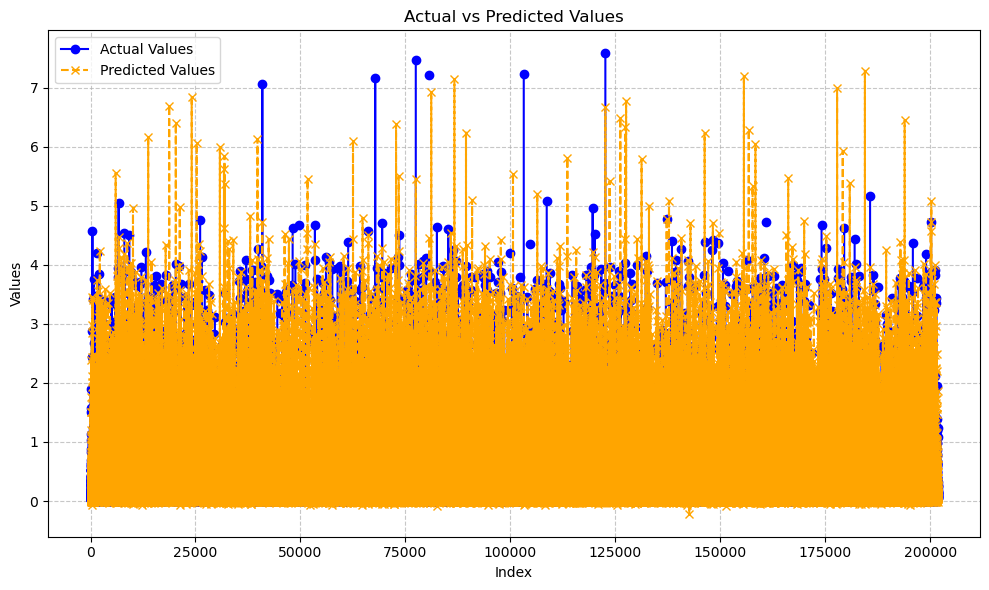

In [235]:
# Plot predicted vs actual values as a line graph
plt.figure(figsize=(10, 6))  # Adjust the figure size as needed
plt.plot(merged_df['actual_values'], label='Actual Values', linestyle='-', marker='o', color='blue')
plt.plot(merged_df['predicted_values'], label='Predicted Values', linestyle='--', marker='x', color='orange')
plt.xlabel('Index')
plt.ylabel('Values')
plt.title('Actual vs Predicted Values')
plt.legend(loc='upper left')
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()  # Improves spacing
plt.show()


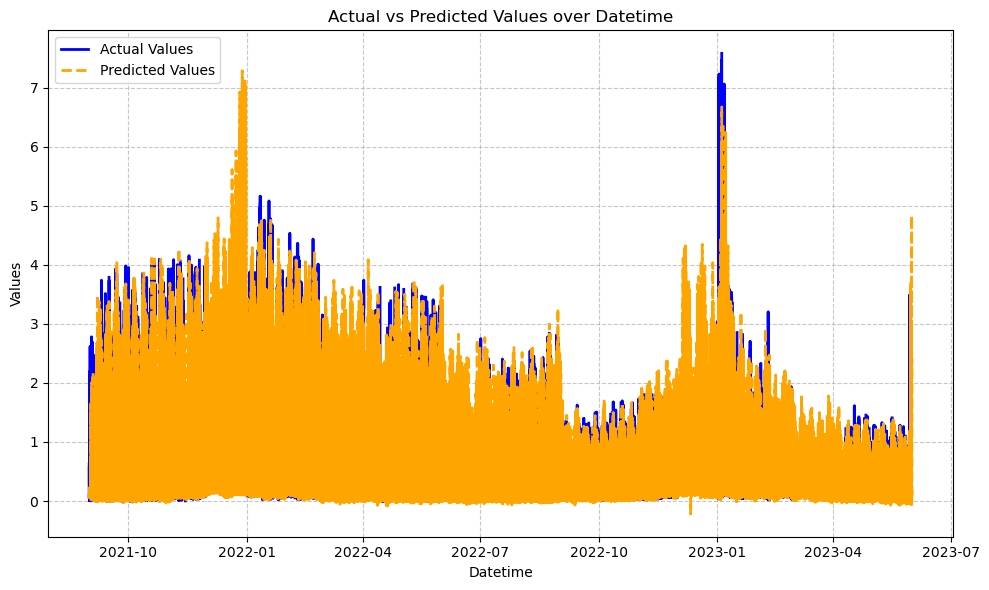

In [239]:
# Assuming 'datetime' is the datetime column in your DataFrame
# If it's not, replace 'datetime' with the actual column name

# Sort the DataFrame by 'datetime' for proper time series plotting
merged_df.sort_values(by='datetime_x', inplace=True)

# Plot actual vs predicted values over datetime_x
plt.figure(figsize=(10, 6))  # Adjust the figure size as needed
plt.plot(merged_df['datetime_x'], merged_df['actual_values'], label='Actual Values', linewidth=2, color='blue')
plt.plot(merged_df['datetime_x'], merged_df['predicted_values'], label='Predicted Values', linestyle='--', linewidth=2, color='orange')
plt.xlabel('Datetime')
plt.ylabel('Values')
plt.title('Actual vs Predicted Values over Datetime')
plt.legend(loc='upper left')
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()  # Improves spacing
plt.show()

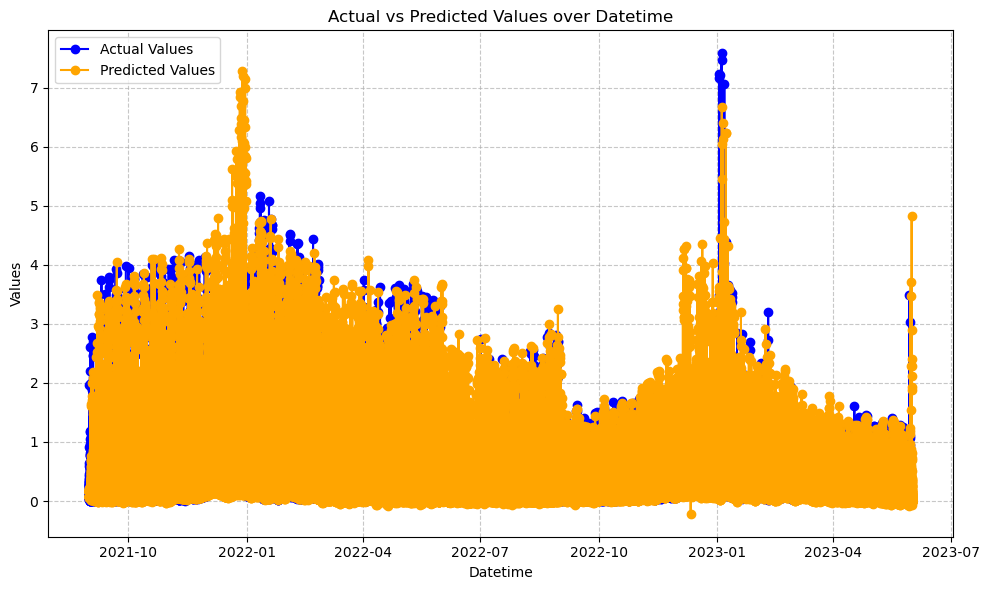

In [243]:
# Sort the DataFrame by 'datetime' for proper time series plotting
merged_df.sort_values(by='datetime_x', inplace=True)

# Plot actual vs predicted values over datetime_x with connected line
plt.figure(figsize=(10, 6))  # Adjust the figure size as needed
plt.plot(merged_df['datetime_x'], merged_df['actual_values'], 'o-', label='Actual Values', color='blue')
plt.plot(merged_df['datetime_x'], merged_df['predicted_values'], 'o-', label='Predicted Values', color='orange')
plt.xlabel('Datetime')
plt.ylabel('Values')
plt.title('Actual vs Predicted Values over Datetime')
plt.legend(loc='upper left')
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()  # Improves spacing
plt.show()

In [245]:
from plotnine import ggplot, aes, geom_line, labs, theme_minimal

# Assuming 'datetime' is the datetime column in your DataFrame
# If it's not, replace 'datetime' with the actual column name

# Sort the DataFrame by 'datetime' for proper time series plotting
merged_df.sort_values(by='datetime', inplace=True)

# Create a ggplot with actual and predicted lines
gg = (
    ggplot(merged_df)
    + aes(x='datetime')
    + geom_line(aes(y='actual_values'), color='blue', size=1, linetype='solid', show_legend=True)
    + geom_line(aes(y='predicted_values'), color='orange', size=1, linetype='dashed', show_legend=True)
    + labs(title='Actual vs Predicted Values over Datetime', x='Datetime', y='Values')
    + theme_minimal()
)

# Show the ggplot
print(gg)

ImportError: cannot import name 'multitype_sort' from 'mizani.utils' (/Users/dcmac14/miniconda3/envs/tensorflow/lib/python3.10/site-packages/mizani/utils.py)

In [232]:
merged_df

,county,is_business,product_type,predicted_values,is_consumption,datetime_x,prediction_unit_id,quarter,month,week,day,hour,dayofweek,dayofyear,jan_flag_x,eic_count_x,installed_capacity_x,avg_installed_cap_x,lowest_price_per_mwh_x,highest_price_per_mwh_x,euros_per_mwh_x,temperature_fcast_mean_x,dewpoint_fcast_mean_x,cloudcover_high_fcast_mean_x,cloudcover_low_fcast_mean_x,cloudcover_mid_fcast_mean_x,cloudcover_total_fcast_mean_x,10_metre_u_wind_component_fcast_mean_x,10_metre_v_wind_component_fcast_mean_x,direct_solar_radiation_fcast_mean_x,surface_solar_radiation_downwards_fcast_mean_x,snowfall_fcast_mean_x,total_precipitation_fcast_mean_x,temperature_fcast_mean_by_county_x,dewpoint_fcast_mean_by_county_x,cloudcover_high_fcast_mean_by_county_x,cloudcover_low_fcast_mean_by_county_x,cloudcover_mid_fcast_mean_by_county_x,cloudcover_total_fcast_mean_by_county_x,10_metre_u_wind_component_fcast_mean_by_county_x,10_metre_v_wind_component_fcast_mean_by_county_x,direct_solar_radiation_fcast_mean_by_county_x,surface_solar_radiation_downwards_fcast_mean_by_county_x,snowfall_fcast_mean_by_county_x,total_precipitation_fcast_mean_by_county_x,temperature_hist_mean_x,dewpoint_hist_mean_x,rain_hist_mean_x,snowfall_hist_mean_x,surface_pressure_hist_mean_x,cloudcover_total_hist_mean_x,cloudcover_low_hist_mean_x,cloudcover_mid_hist_mean_x,cloudcover_high_hist_mean_x,windspeed_10m_hist_mean_x,winddirection_10m_hist_mean_x,shortwave_radiation_hist_mean_x,direct_solar_radiation_hist_mean_x,diffuse_radiation_hist_mean_x,temperature_hist_mean_by_county_x,dewpoint_hist_mean_by_county_x,rain_hist_mean_by_county_x,snowfall_hist_mean_by_county_x,surface_pressure_hist_mean_by_county_x,cloudcover_total_hist_mean_by_county_x,cloudcover_low_hist_mean_by_county_x,cloudcover_mid_hist_mean_by_county_x,cloudcover_high_hist_mean_by_county_x,windspeed_10m_hist_mean_by_county_x,winddirection_10m_hist_mean_by_county_x,shortwave_radiation_hist_mean_by_county_x,direct_solar_radiation_hist_mean_by_county_x,diffuse_radiation_hist_mean_by_county_x,is_holiday_x,target_lag_1_days_ago_x,target_lag_2_days_ago_x,target_lag_3_days_ago_x,sin_hour_x,cos_hour_x,sin_dayofyear_x,cos_dayofyear_x,target_mean_x,target_std_x,target_var_x,log_installed_capacity_x,log_euros_per_mwh_x,log_temperature_fcast_mean_x,log_dewpoint_fcast_mean_x,log_cloudcover_high_fcast_mean_x,log_cloudcover_low_fcast_mean_x,log_cloudcover_mid_fcast_mean_x,log_cloudcover_total_fcast_mean_x,log_10_metre_u_wind_component_fcast_mean_x,log_direct_solar_radiation_fcast_mean_x,log_snowfall_fcast_mean_x,log_total_precipitation_fcast_mean_x,log_temperature_fcast_mean_by_county_x,log_dewpoint_fcast_mean_by_county_x,log_cloudcover_high_fcast_mean_by_county_x,log_cloudcover_low_fcast_mean_by_county_x,log_cloudcover_mid_fcast_mean_by_county_x,log_cloudcover_total_fcast_mean_by_county_x,log_10_metre_u_wind_component_fcast_mean_by_county_x,log_10_metre_v_wind_component_fcast_mean_x,log_10_metre_v_wind_component_fcast_mean_by_county_x,log_surface_solar_radiation_downwards_fcast_mean_by_county_x,log_snowfall_fcast_mean_by_county_x,log_total_precipitation_fcast_mean_by_county_x,log_rain_hist_mean_x,log_snowfall_hist_mean_x,log_windspeed_10m_hist_mean_by_county_x,log_target_lag_1_days_ago_x,log_target_lag_2_days_ago_x,log_target_lag_3_days_ago_x,log_target_mean_x,log_target_std_x,log_target_var_x,actual_values,datetime_y,jan_flag_y,eic_count_y,installed_capacity_y,avg_installed_cap_y,lowest_price_per_mwh_y,highest_price_per_mwh_y,euros_per_mwh_y,temperature_fcast_mean_y,dewpoint_fcast_mean_y,cloudcover_high_fcast_mean_y,cloudcover_low_fcast_mean_y,cloudcover_mid_fcast_mean_y,cloudcover_total_fcast_mean_y,10_metre_u_wind_component_fcast_mean_y,10_metre_v_wind_component_fcast_mean_y,direct_solar_radiation_fcast_mean_y,surface_solar_radiation_downwards_fcast_mean_y,snowfall_fcast_mean_y,total_precipitation_fcast_mean_y,temperature_fcast_mean_by_county_y,dewpoint_fcast_mean_by_county_y,cloudcover_high_fcast_mean_by_county_y,cloudcove

In [120]:
# Invert predictions
consumption_yhat = scaler.inverse_transform(consumption_yhat)
consumption_y_test = scaler.inverse_transform([consumption_y_test])

production_yhat = scaler.inverse_transform(production_yhat)
production_y_test = scaler.inverse_transform([production_y_test])

ValueError: non-broadcastable output operand with shape (201783,1) doesn't match the broadcast shape (201783,115)

## Submission

In [ ]:
def TestPreprocessing(test, client_df, fw_df, electricity_df, gas_df, locations, hw_df):
    '''Test data preprocessing'''

    # Converting to datetime & date feature engineering
    test = test.rename(columns={'prediction_datetime' : 'datetime'})

    test['datetime'] = pd.to_datetime(test['datetime'], utc=True)

    test['year'] = test['datetime'].dt.year
    test['quarter'] = test['datetime'].dt.quarter
    test['month'] = test['datetime'].dt.month
    test['week'] = test['datetime'].dt.isocalendar().week
    test['day'] = test['datetime'].dt.day
    test['hour'] = test['datetime'].dt.hour
    test['dayofweek'] = test['datetime'].dt.dayofweek
    test['dayofyear'] = test['datetime'].dt.dayofyear

    test['week'] = test['week'].astype('int64')

    test["jan_flag"] = (test["month"] == 1).astype(int)

    # Client data processing
    # Subtracting 2 from data_block_id. Data is two steps ahead
    client_df['data_block_id'] -= 2
    
    # Average installed capacity. (installed_capacity / eic_count)
    client_df['avg_installed_cap'] = client_df['installed_capacity'] / client_df['eic_count']

    
    # Electricity data processing
    # Renaming (forecast_date) to (datetime) for merging with the test data later
    electricity_df = electricity_df.rename(columns= {'forecast_date' : 'datetime'})
    
    # Converting (datetime) column to datetime
    electricity_df['datetime'] = pd.to_datetime(electricity_df['datetime'], utc= True)
    
    electricity_df['hour'] = electricity_df['datetime'].dt.hour
    
    # Locations data processing
    # Drop
    locations = locations.drop('Unnamed: 0', axis= 1) 
        

    # Forecast Weather 
    # 1. Rounding lat & lon to 1 decimal place
    # 2. Merge counties data from locations DF to lat & lon in forecast weather df
    # 3. Drop null rows
    # 4. Convert county col to int dtype
    # 5. Drop un-necessary columns
    # 6. Rename date column to 'datetime' and convert to datetime dtype
    # 7. New df with mean weather values per hour. Convert datetime back to normal datetime format in new df.
    # 8. New df with mean values per hour grouped also by county. Convert datetime col back to datetime.
    
    # 1.
    fw_df[['latitude', 'longitude']] = fw_df[['latitude', 'longitude']].astype(float).round(1)
    
    # 2.
    fw_df = fw_df.merge(locations, how='left', on=['latitude', 'longitude'])
    
    # 3.
    fw_df.dropna(axis=0, inplace=True)
    
    # 4.
    fw_df['county'] = fw_df['county'].astype('int64')
    
    # 5.
    fw_df.drop(['origin_datetime', 'latitude', 'longitude', 'hours_ahead',
               'data_block_id'], axis=1, inplace=True)
    
    # 6.
    fw_df.rename(columns={'forecast_datetime': 'datetime'}, inplace=True)
    fw_df['datetime'] = pd.to_datetime(fw_df['datetime'], utc=True)
    
    # 7.
    fw_df_mean = fw_df.groupby([fw_df['datetime']
                                .dt.to_period('h')])[list(fw_df.drop(['county', 'datetime'], axis=1)
                                                                           .columns)].mean().reset_index()
    fw_df_mean['datetime'] = pd.to_datetime(fw_df_mean['datetime'].dt.to_timestamp(), utc=True)
    
    # 8. 
    fw_df_county = fw_df.groupby(['county', fw_df['datetime'].dt.to_period('h')])[list(fw_df.drop(['county', 'datetime'], axis=1).columns)].mean().reset_index()
    fw_df_county['datetime'] = pd.to_datetime(fw_df_county['datetime'].dt.to_timestamp(), utc=True)

    
    # Historical weather df processing
    # 1. Rounding lat & lon to 1 decimal place
    # 2. Merge counties data from locations DF to lat & lon in forecast weather df
    # 3. Drop null rows
    # 4. Convert county col to int dtype
    # 5. Drop un-necessary columns
    # 6. Rename date column to 'datetime' and convert to datetime dtype
    # 7. New df with mean weather values per hour. Convert datetime back to normal datetime format in new df.
    # 8. New df with mean values per hour grouped also by county. Convert datetime col back to datetime.
    # 9. Merge data_block_id back to new county df
   
    # 1.
    hw_df[['latitude', 'longitude']] = hw_df[['latitude', 'longitude']].astype(float).round(1)
    
    # 2.
    hw_df = hw_df.merge(locations, how='left', on=['longitude', 'latitude'])
    
    # 3.
    hw_df.dropna(axis=0, inplace=True)
    
    # 4.
    hw_df['county'] = hw_df['county'].astype('int64')
    
    # 5.
    hw_df.drop(['latitude', 'longitude'], axis=1, inplace=True)
    
    # 6.
    hw_df['datetime'] = pd.to_datetime(hw_df['datetime'], utc=True)
    
    # 7.
    hw_df_mean = hw_df.groupby([hw_df['datetime']
                                .dt.to_period('h')])[list(hw_df.drop(['county', 'datetime', 'data_block_id'], axis=1)
                                                                           .columns)].mean().reset_index()
    hw_df_mean['datetime'] = pd.to_datetime(hw_df_mean['datetime'].dt.to_timestamp(), utc=True)
    
    hw_df_mean = hw_df_mean.merge(hw_df[['datetime', 'data_block_id']], how='left', on='datetime')
    
    # 8. 
    hw_df_county = hw_df.groupby(['county', hw_df['datetime'].dt.to_period('h')])[list(hw_df.drop(['county', 'datetime', 'data_block_id'], axis=1).columns)].mean().reset_index()
    hw_df_county['datetime'] = pd.to_datetime(hw_df_county['datetime'].dt.to_timestamp(), utc=True)
    hw_df_county = hw_df_county.merge(hw_df[['datetime', 'data_block_id']], how='left', on='datetime')
    hw_df_county.drop_duplicates(inplace=True)
    hw_df_county.reset_index()
    
    # Merge the data into test set
    # 1. Merge client 
    # 2. Merge gas
    # 3. Merge electricity
    # 4. Merge forecast weather
    # 5. Merge forecast weather by county
    # 6. Add hour col to hist weather and hist county. Drop dups and datetime col
    # 7. Merge hist weather menas
    # 8. Merge hist weather means by county
    # 9. Fill null values with forward and backward method
    # 10. Drop un-necessary cols...?

    
    # 1
    test = test.merge(client_df.drop(columns = ['date']), how='left', on = ['data_block_id', 'county', 'is_business', 'product_type'])
    
    # 2
    test = test.merge(gas_df[['data_block_id', 'lowest_price_per_mwh', 'highest_price_per_mwh']], how='left', on='data_block_id')
    
    # 3
    test = test.merge(electricity_df[['euros_per_mwh', 'hour', 'data_block_id']], how='left', on=['hour','data_block_id'])
    
    # 4 
    test = test.merge(fw_df_mean, how='left', on='datetime')
    
    # 5 
    test = test.merge(fw_df_county, how='left', on=['datetime', 'county'], suffixes = ('_fcast_mean', '_fcast_mean_by_county'))
    
    # 6
    hw_df_mean['hour'] = hw_df_mean['datetime'].dt.hour
    hw_df_county['hour'] = hw_df_county['datetime'].dt.hour
    
    hw_df_mean.drop_duplicates(inplace=True)
    hw_df_county.drop_duplicates(inplace=True)
    hw_df_mean.drop('datetime', axis=1, inplace=True)
    hw_df_county.drop('datetime', axis=1, inplace=True)

    # 7
    test = test.merge(hw_df_mean, how='left', on=['data_block_id', 'hour'])
    
    # 8 
    test = test.merge(hw_df_county, how='left', on=['data_block_id', 'county', 'hour'], suffixes= ('_hist_mean', '_hist_mean_by_county'))
    
    # 9
    test = test.groupby(['year', 'day', 'hour'], as_index=False).apply(lambda x: x.ffill().bfill()).reset_index()
    
    # 10
    test.drop(['row_id', 'data_block_id'], axis = 1, inplace = True)

    # Fill in missing values
    test['installed_capacity'] = test['installed_capacity'].fillna(1000)

    return test

In [ ]:
def create_revealed_targets_test(data, previous_revealed_targets, N_lags):
    '''🎯 Create new test data based on previous_revealed_targets and N_day_lags 🎯 ''' 
    for count, revealed_targets in enumerate(previous_revealed_targets) :
        day_lag = count + 1
        
        # Get hour
        revealed_targets['hour'] = pd.to_datetime(revealed_targets['datetime'], utc= True).dt.hour
        
        # Select columns and rename target
        revealed_targets = revealed_targets[['hour', 'prediction_unit_id', 'is_consumption', 'target']]
        revealed_targets = revealed_targets.rename(columns = {"target" : f"target_{day_lag}_days_ago"})
        
        
        # Add past revealed targets
        data = pd.merge(data,
                        revealed_targets,
                        how = 'left',
                        on = ['hour', 'prediction_unit_id', 'is_consumption'],
                       )
        
    # If revealed_target_columns not available, replace by nan
    all_revealed_columns = [f"target_{day_lag}_days_ago" for day_lag in range(1, N_lags+1)]
    missing_columns = list(set(all_revealed_columns) - set(data.columns))
    data[missing_columns] = np.nan 
    
    return data

In [ ]:
iter_test = test, revealed_targets, client_test, hw_historical_weather_test, forecast_weather_test, electricity_test, gas_test,sample_prediction

In [1]:
#env = enefit.make_env()
#iter_test = env.iter_test()
previous_revealed_targets = []
for (test, revealed_targets, client_test, hw_historical_weather_test,
     forecast_weather_test, electricity_test, gas_test,sample_prediction) in iter_test:
    
    # Initiate column data_block_id with default value to merge the data on
    id_column = 'data_block_id' 
    
    test[id_column] = 0
    gas_test[id_column] = 0
    electricity_test[id_column] = 0
    hw_historical_weather_test[id_column] = 0
    forecast_weather_test[id_column] = 0
    client_test[id_column] = 0
    revealed_targets[id_column] = 0

    data_test = TestPreprocessing(test, client_test, forecast_weather_test, electricity_test, gas_test, locations, historical_weather_test)
    data_test = is_holiday(data_test)
    
    # Drop year column as its no longer needed
    data_test.drop(['year'], axis=1, inplace=True)
    data_test['datetime']= pd.to_datetime(data_test['datetime'], utc= True).astype('int64')
    
    # Store revealed_targets
    previous_revealed_targets.insert(0, revealed_targets)
    if len(previous_revealed_targets) == N_lags:
        previous_revealed_targets.pop()
    
    # Add previous revealed targets
    df_test = create_revealed_targets_test(data = data_test.copy(),
                                           previous_revealed_targets = previous_revealed_targets.copy(),
                                           N_lags = N_lags
                                          )
    #Data Transformation
    df_test['sin_hour']= (np.pi * np.sin(df_test['hour']) / 12)
    df_test['cos_hour']= (np.pi * np.cos(df_test['hour']) / 12)
    df_test['sin_dayofyear']= (np.pi * np.sin(df_test['dayofyear']) / 183)
    df_test['cos_dayofyear']= (np.pi * np.cos(df_test['dayofyear']) / 183)
    df_test['target_mean']= df_test[[f'target_{i}_days_ago' for i in range(1, N_lags+1)]].mean(1)
    df_test['target_std']= df_test[[f'target_{i}_days_ago' for i in range(1, N_lags+1)]].std(1)
    df_test['target_var']= df_test[[f'target_{i}_days_ago' for i in range(1, N_lags+1)]].var(1)
    for i in to_log:
        df_test[f"log_{i}"]= np.where((df_test[i])!= 0, np.log(df_test[i]),0)
    X_test = df_test.drop('currently_scored', axis= 1).values

    # sort by datetime
    X_test.sort_values(['datetime', 'hour'], inplace=True)

    # Normalize features
    X_test = scaler.fit_transform(X_test)

    # Reshape features for LSTM
    X_test = X_test.reshape((X_test.shape[0], 1, X_test.shape[1]))

    # Split into consumption and production
    consumption_test = X_test[X_test['is_consumption'] == 1].drop(['is_consumption'], axis=1)
    production_test = X_test[X_test['is_consumption'] == 0].drop(['is_consumption'], axis=1)

    #Predictions
    target = []
    target_solar = []
    target['target'] = consumption_model.predict(consumption_test).clip(0)
    target_solar['target_solar'] = production_model.predict(production_test).clip(0)

    
    # Merge predictions back to original df
    test = test.merge(target, how='left', on='datetime')
    test = test.merge(target_solar, how='left', on='datetime')

    # if the row is solar, use target_solar, else use target
    test['target'] = np.where(test['is_consumption'] == 0, test['target_solar'], test['target'])
    
    # Add installed capacity
    test['target'] = test['target'] * test['installed_capacity']
    
    sample_prediction["target"] = test['target']
    
    #Sending predictions to the API
    env.predict(sample_prediction)

NameError: name 'enefit' is not defined